<a href="https://colab.research.google.com/github/pandian-raja/EVA4_Session15/blob/master/All_output_Grayscale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/pandian-raja/EVA4_Session15.git


Cloning into 'EVA4_Session15'...
remote: Enumerating objects: 99, done.
remote: Counting objects: 100% (99/99), done.
remote: Compressing objects: 100% (89/89), done.
remote: Total 99 (delta 45), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (99/99), done.


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
%cd EVA4_Session15

/content/EVA4_Session15


In [0]:
import GetData2 as gd
import model.RGBmodel as rg
import utils as util
from torch import nn
from torch.optim.lr_scheduler import StepLR
import torch


In [24]:
train_loader = gd.importDataset()


40000
40000
40000
40000


In [0]:
device = torch.device('cuda:0')
model = rg.ResNetInspired(rg.BasicBlock, [1,1,1,1]).to(device)
# summary(model, (3, 128, 128))

In [0]:
def train(model, criterion, device, train_loader, optimizer, epoch):
    model.train()
    for batch_idx, data in enumerate(train_loader):
        data["f1"] = data["f1"].to(device)
        data["f2"] = data["f2"].to(device)
        data["f3"] = data["f3"].to(device)
        data["f4"] = data["f4"].to(device)
        optim.zero_grad()
        output = model(data)
        # print(len(output))
        loss1 = criterion(output[0], data["f4"])
        # print((output[0].shape))
        # print((data["f4"].shape))
        # print((output[1].shape))
        # print((data["f3"].shape))
        
        loss2 = criterion(output[1], data["f3"])
        
        loss = 2*loss1+loss2
        loss.backward()
        optim.step()
        if batch_idx % 500 == 0:
            print(loss1)
            print(loss2)
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\t Loss: {:.6f}'.format(
                epoch, batch_idx * len(data), len(train_loader.dataset),
                100.*batch_idx/ len(train_loader), loss.item()))
            print('Batch ID:', batch_idx)
            # img_grid1 = tensorboardImage(output[0].detach().cpu(), nrow=2) #nrow = sqrt-bs
            # img_grid2 = tensorboardImage(output[1].detach().cpu(), nrow=2) #nrow = sqrt-bs
            # writer.add_image('Mask', img_grid1)
            # writer.add_image('Depth', img_grid2)
            show_pred(output[0].detach().cpu(), nrow=2) #nrow = sqrt-bs
            show_pred(output[1].detach().cpu(), nrow=2) #nrow = sqrt-bs
            
            # if batch_idx % 500 == 0:
            #     torch.save(model.sate_dict(), PATH/f"{batch_idx}.pth")
        


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6256, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0511, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [0/40000 (0%)]	 Loss: 1.302388
Batch ID: 0


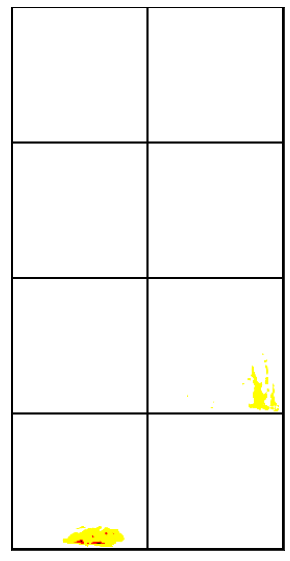

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


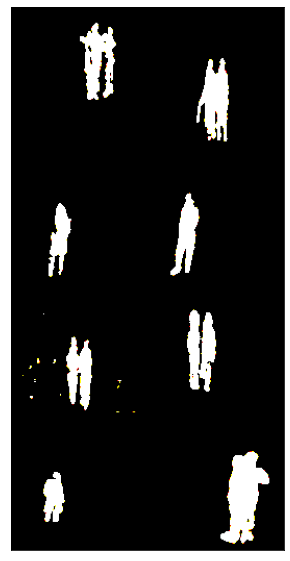

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6149, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0571, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [2000/40000 (10%)]	 Loss: 1.286821
Batch ID: 500


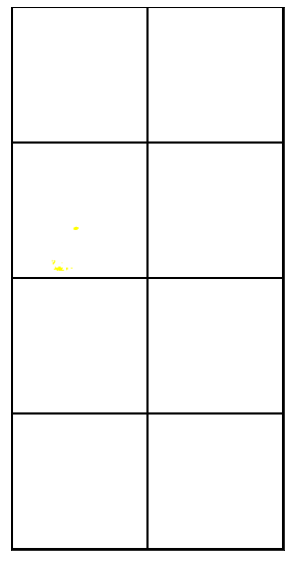

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


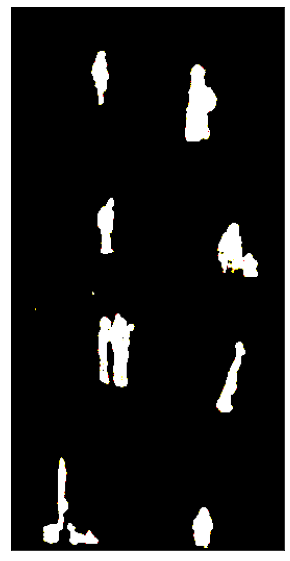

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6579, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0312, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [4000/40000 (20%)]	 Loss: 1.347019
Batch ID: 1000


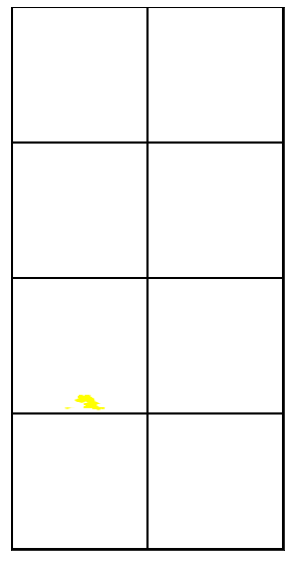

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


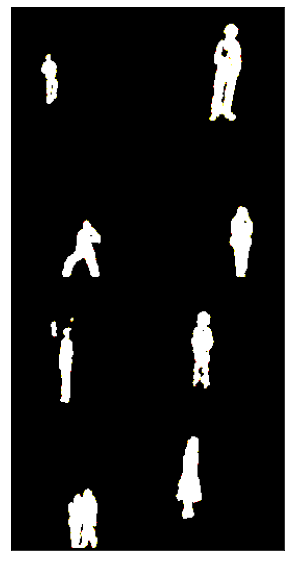

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6427, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0396, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [6000/40000 (30%)]	 Loss: 1.324931
Batch ID: 1500


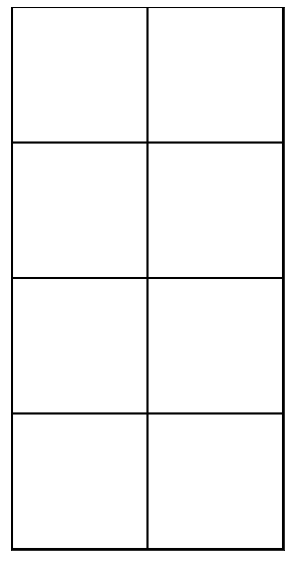

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


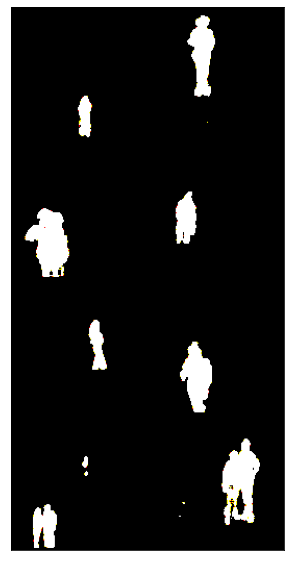

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6197, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0301, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [8000/40000 (40%)]	 Loss: 1.269428
Batch ID: 2000


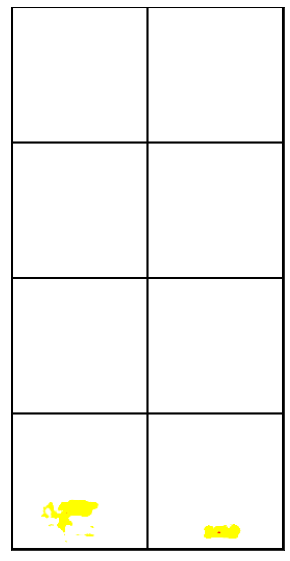

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


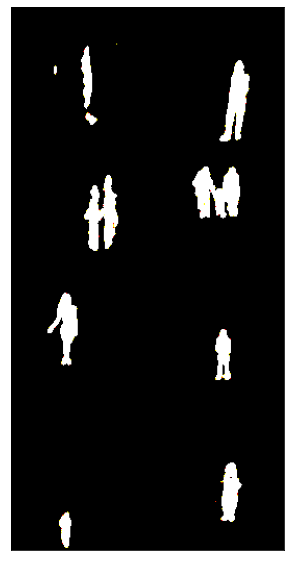

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.5910, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0377, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [10000/40000 (50%)]	 Loss: 1.219756
Batch ID: 2500


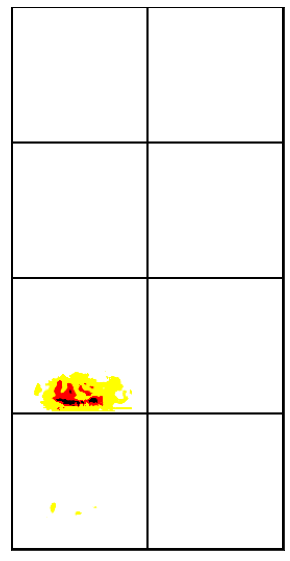

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


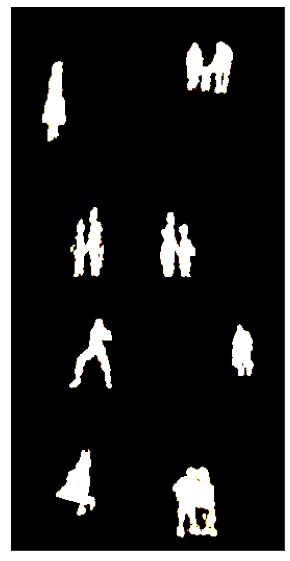

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6442, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0349, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [12000/40000 (60%)]	 Loss: 1.323221
Batch ID: 3000


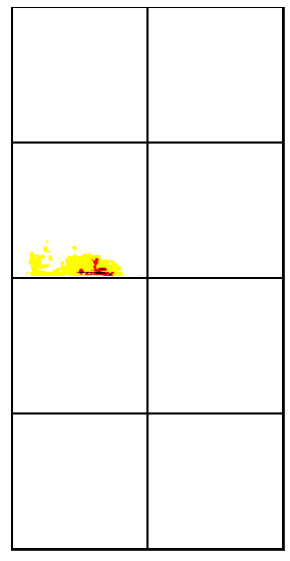

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


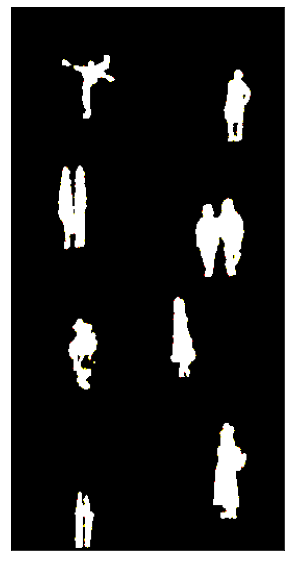

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6211, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0347, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [14000/40000 (70%)]	 Loss: 1.276769
Batch ID: 3500


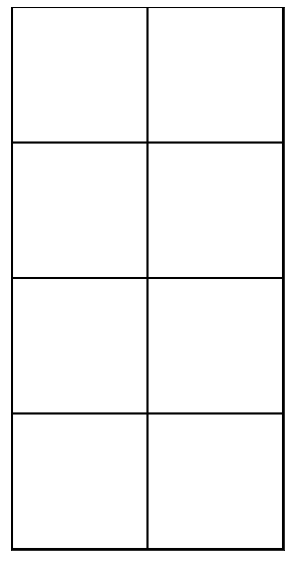

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


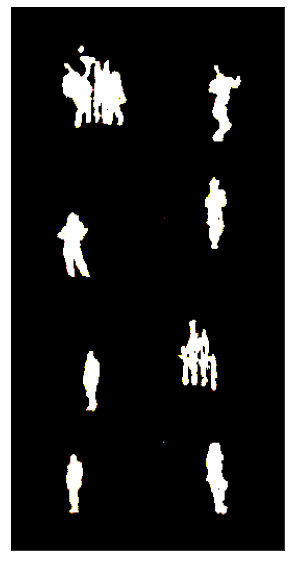

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6276, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0359, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [16000/40000 (80%)]	 Loss: 1.290965
Batch ID: 4000


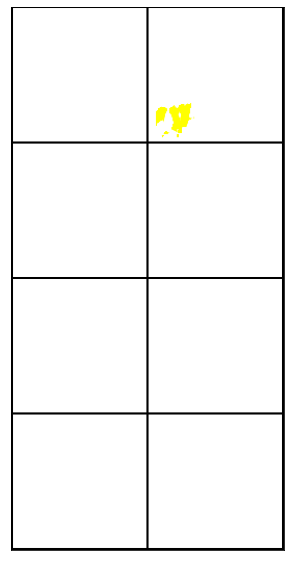

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


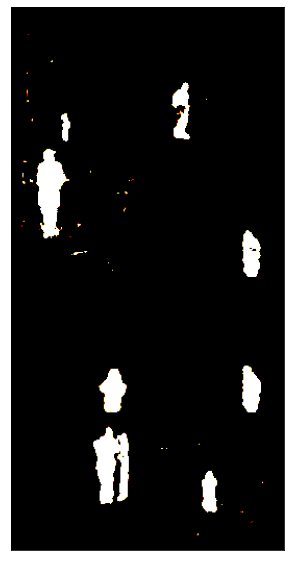

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6251, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0475, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 1 [18000/40000 (90%)]	 Loss: 1.297743
Batch ID: 4500


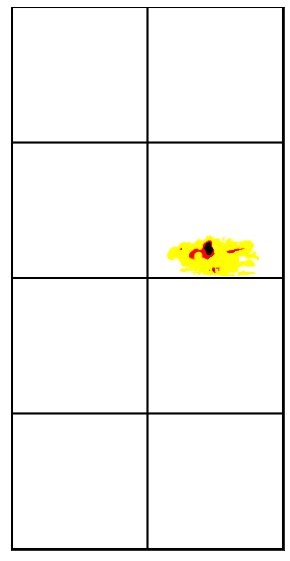

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


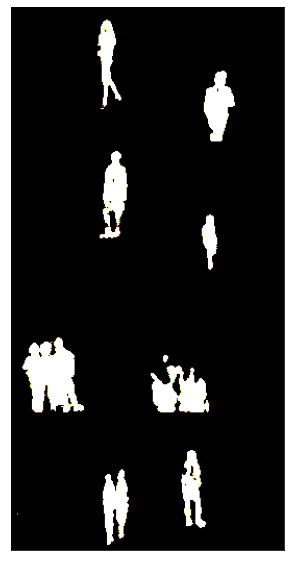

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6331, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0409, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [0/40000 (0%)]	 Loss: 1.306993
Batch ID: 0


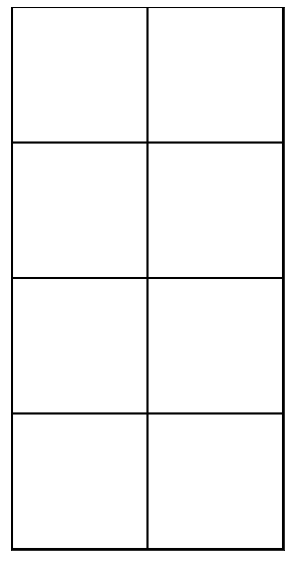

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


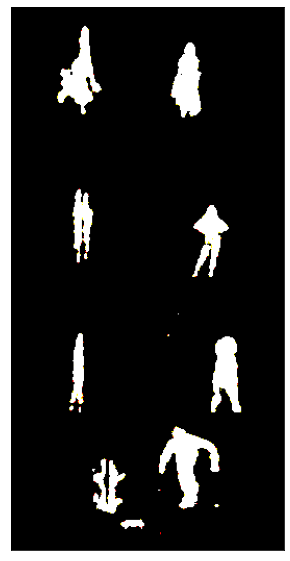

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6153, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0368, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [2000/40000 (10%)]	 Loss: 1.267479
Batch ID: 500


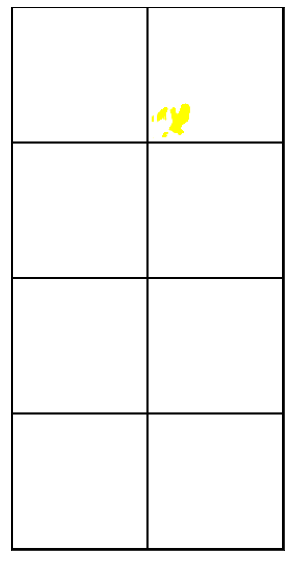

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


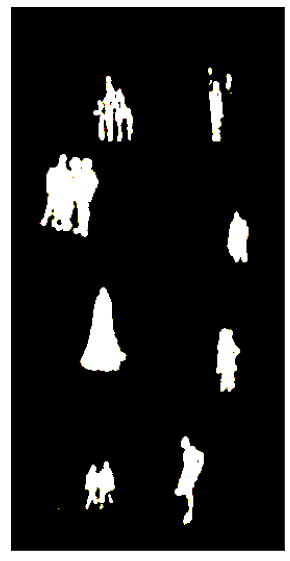

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6259, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0331, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [4000/40000 (20%)]	 Loss: 1.284983
Batch ID: 1000


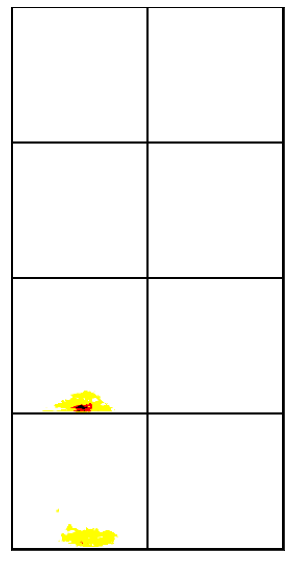

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


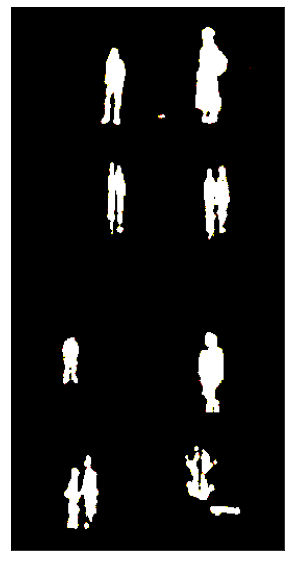

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6007, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0405, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [6000/40000 (30%)]	 Loss: 1.241831
Batch ID: 1500


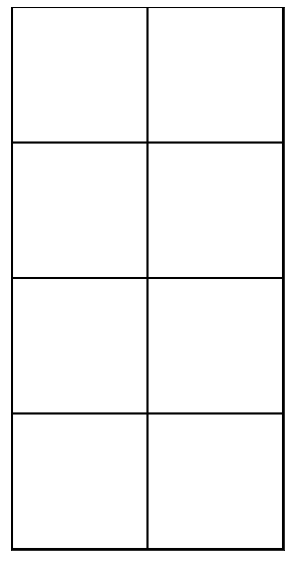

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


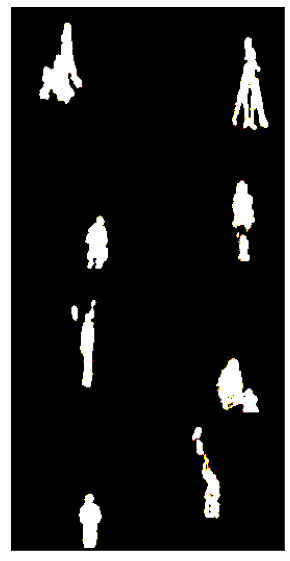

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6506, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0498, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [8000/40000 (40%)]	 Loss: 1.350926
Batch ID: 2000


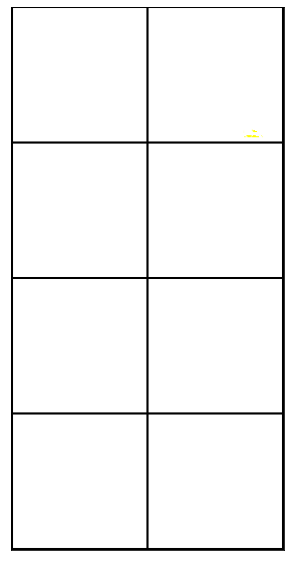

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


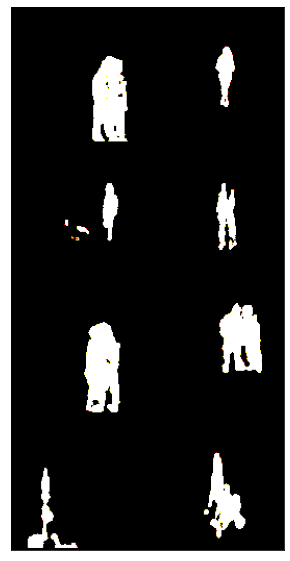

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6352, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0317, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [10000/40000 (50%)]	 Loss: 1.302050
Batch ID: 2500


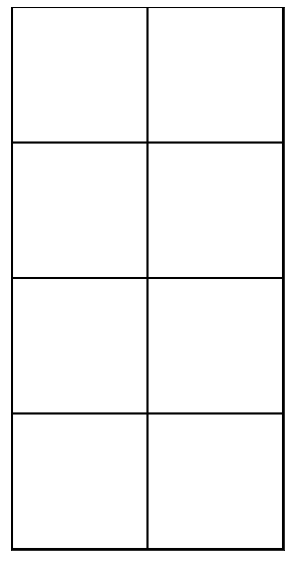

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


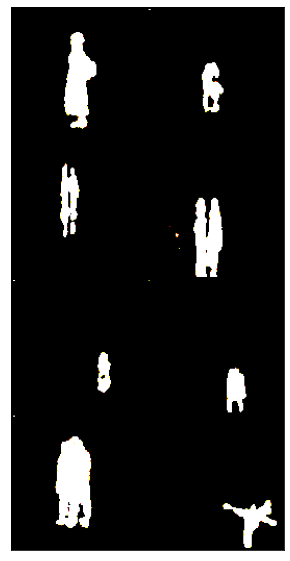

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6340, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0552, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [12000/40000 (60%)]	 Loss: 1.323145
Batch ID: 3000


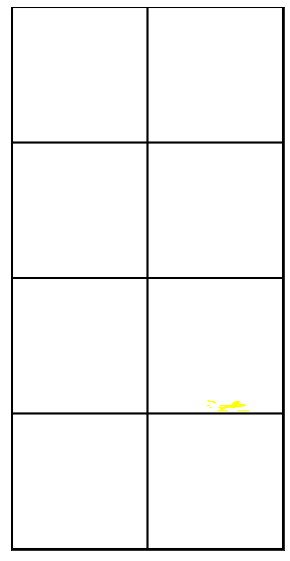

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


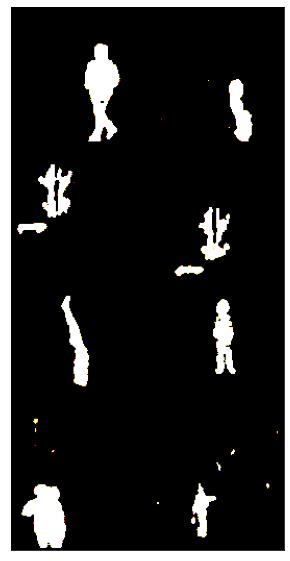

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6149, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0275, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [14000/40000 (70%)]	 Loss: 1.257211
Batch ID: 3500


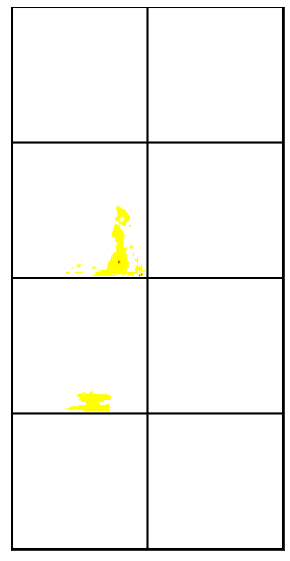

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


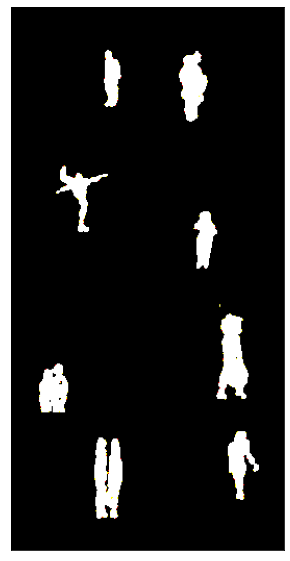

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6077, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0334, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [16000/40000 (80%)]	 Loss: 1.248692
Batch ID: 4000


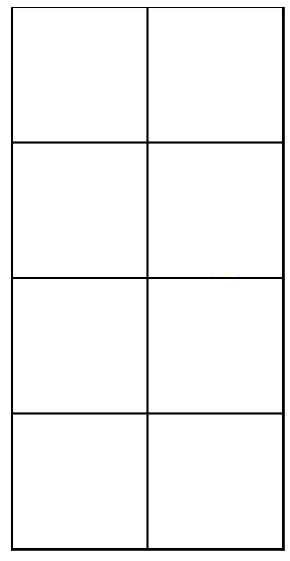

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


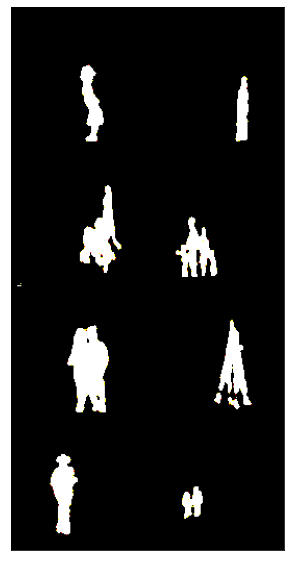

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.5934, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0430, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 2 [18000/40000 (90%)]	 Loss: 1.229737
Batch ID: 4500


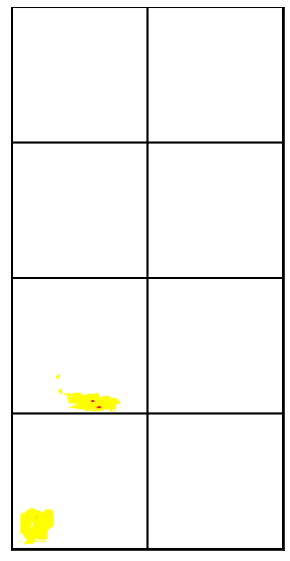

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


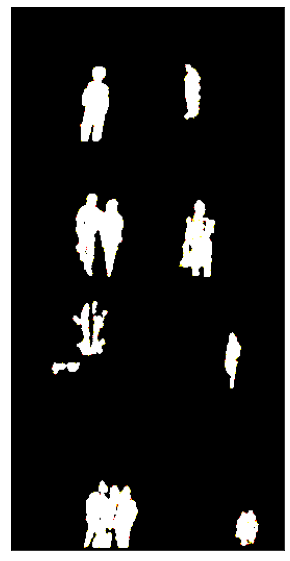

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6458, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [0/40000 (0%)]	 Loss: 1.317624
Batch ID: 0


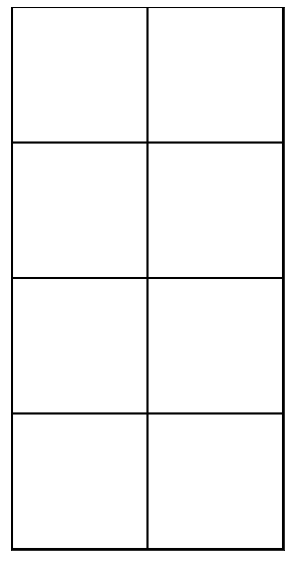

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


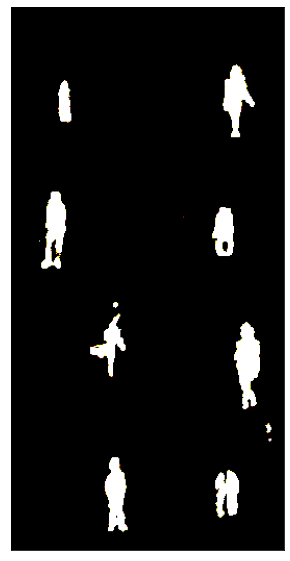

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6154, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [2000/40000 (10%)]	 Loss: 1.255976
Batch ID: 500


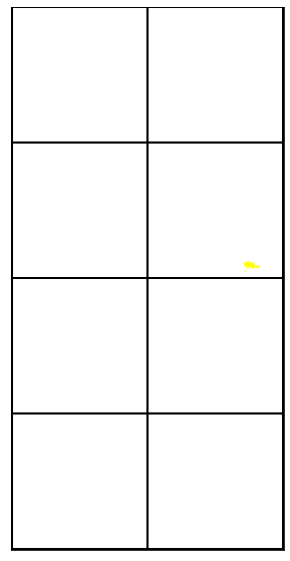

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


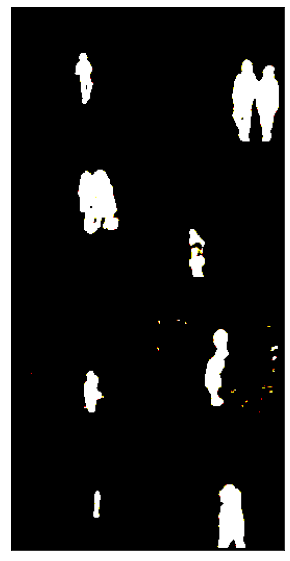

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6249, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0313, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [4000/40000 (20%)]	 Loss: 1.281036
Batch ID: 1000


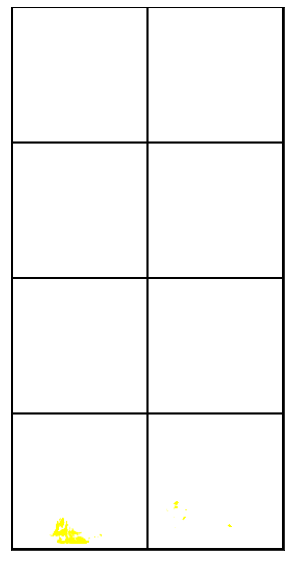

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


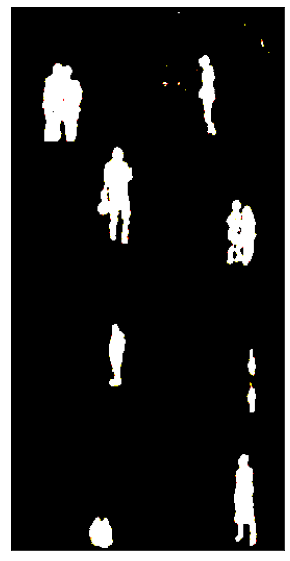

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6101, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0395, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [6000/40000 (30%)]	 Loss: 1.259721
Batch ID: 1500


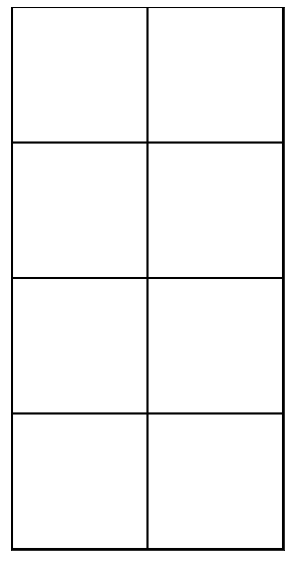

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


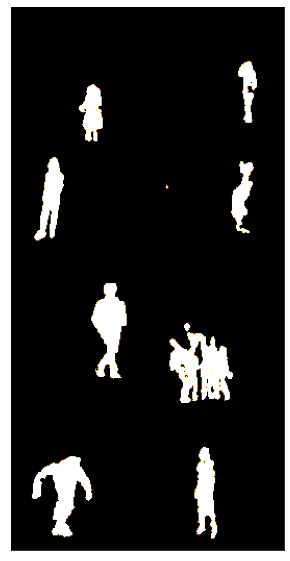

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6359, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0314, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [8000/40000 (40%)]	 Loss: 1.303238
Batch ID: 2000


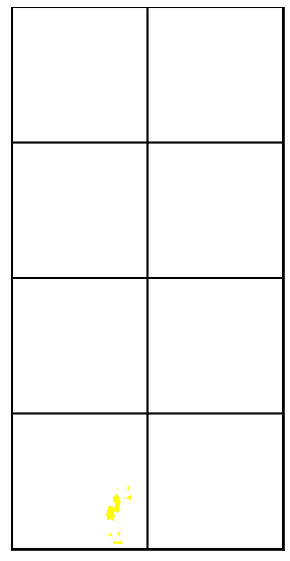

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


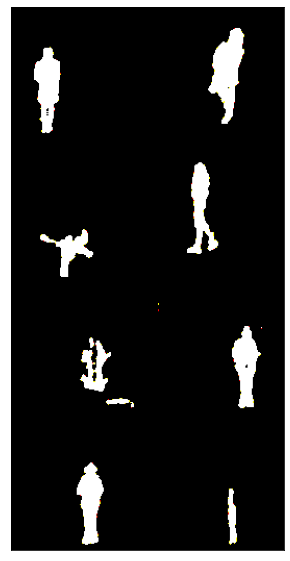

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6493, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0309, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [10000/40000 (50%)]	 Loss: 1.329530
Batch ID: 2500


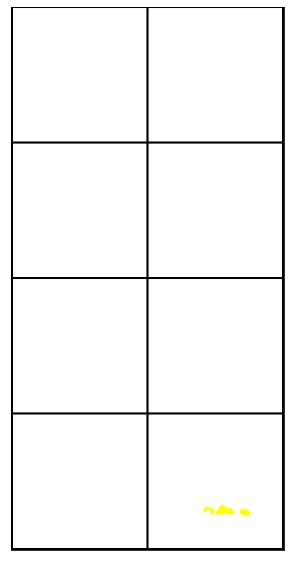

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


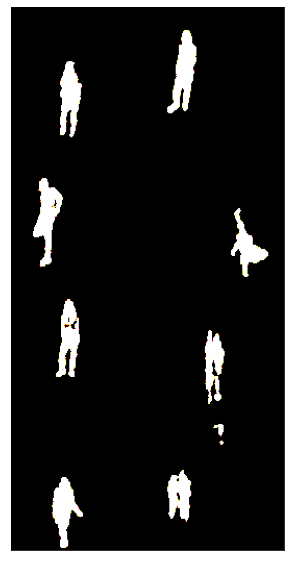

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6265, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0386, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [12000/40000 (60%)]	 Loss: 1.291540
Batch ID: 3000


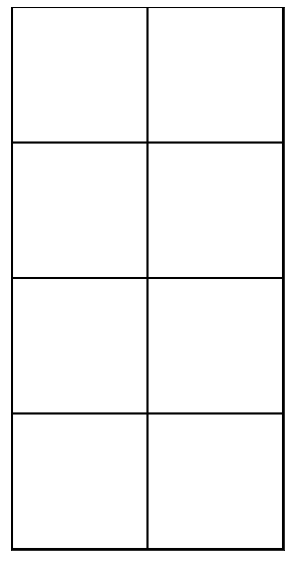

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


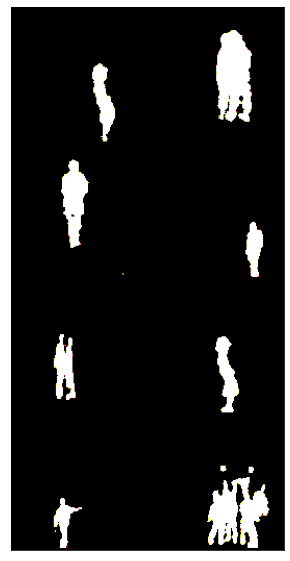

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6184, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0292, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [14000/40000 (70%)]	 Loss: 1.266080
Batch ID: 3500


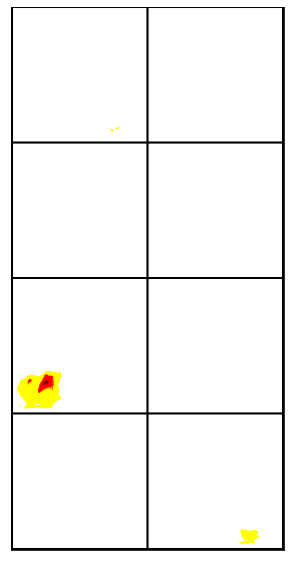

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


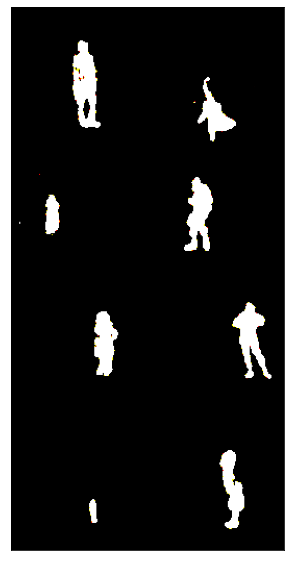

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6284, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0285, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [16000/40000 (80%)]	 Loss: 1.285319
Batch ID: 4000


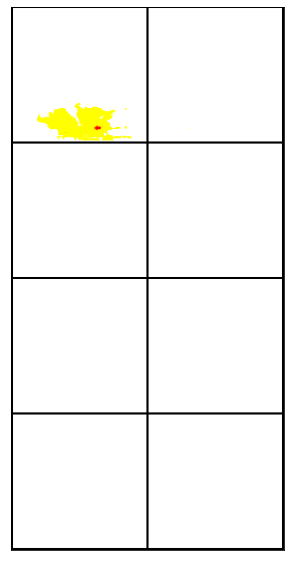

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


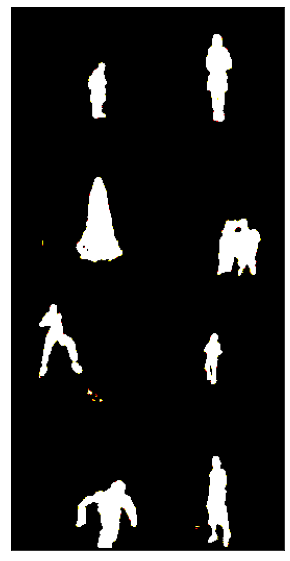

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6582, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0395, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 3 [18000/40000 (90%)]	 Loss: 1.355904
Batch ID: 4500


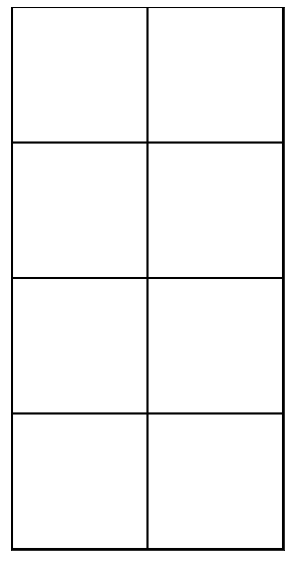

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


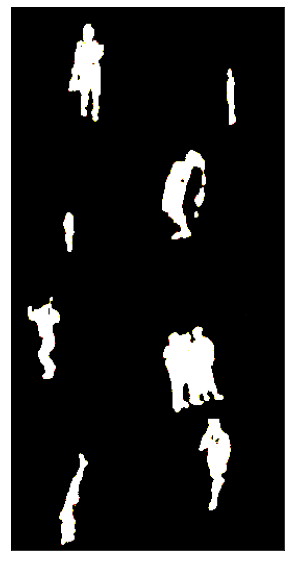

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.5770, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0417, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [0/40000 (0%)]	 Loss: 1.195751
Batch ID: 0


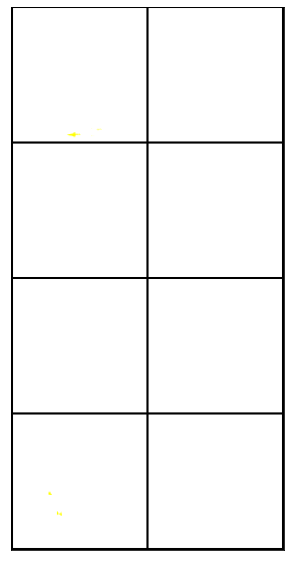

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


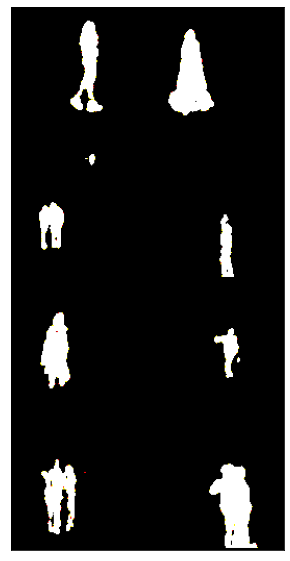

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6298, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0303, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [2000/40000 (10%)]	 Loss: 1.289941
Batch ID: 500


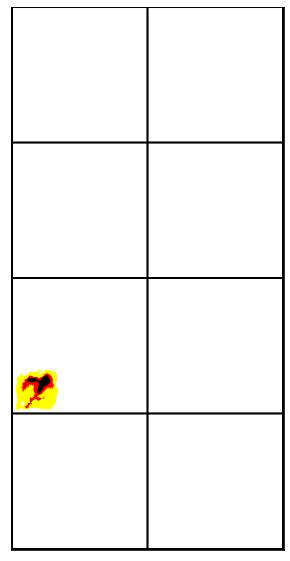

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


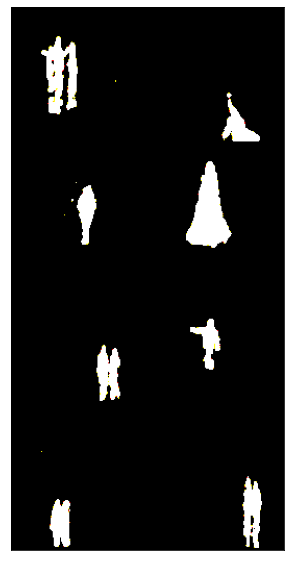

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6376, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [4000/40000 (20%)]	 Loss: 1.300415
Batch ID: 1000


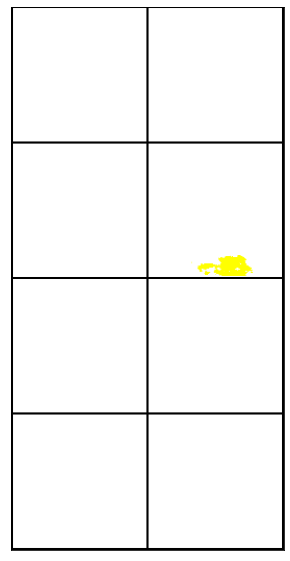

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


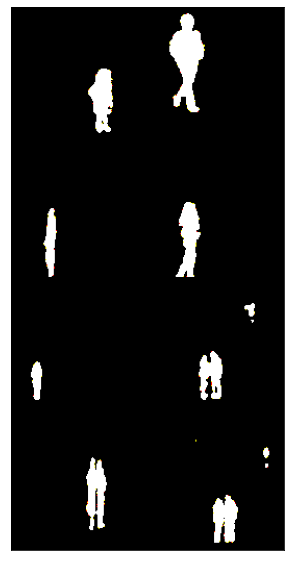

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.5912, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0449, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [6000/40000 (30%)]	 Loss: 1.227326
Batch ID: 1500


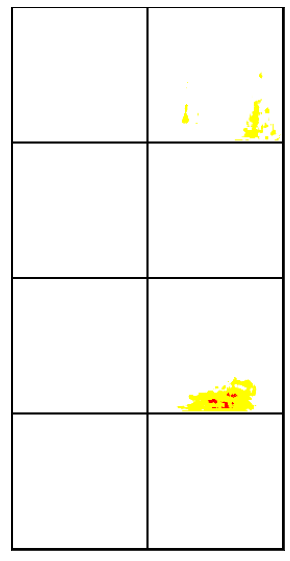

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


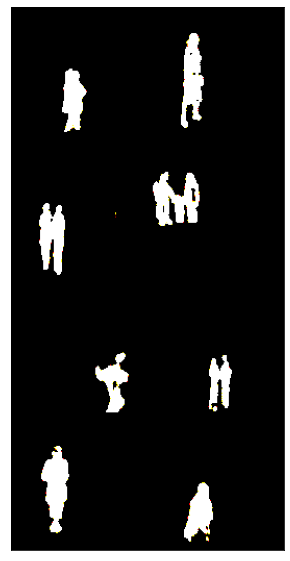

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6175, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0431, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [8000/40000 (40%)]	 Loss: 1.278032
Batch ID: 2000


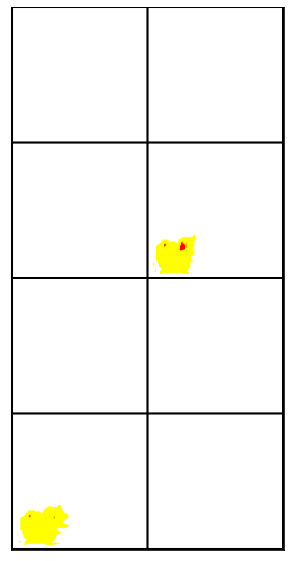

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


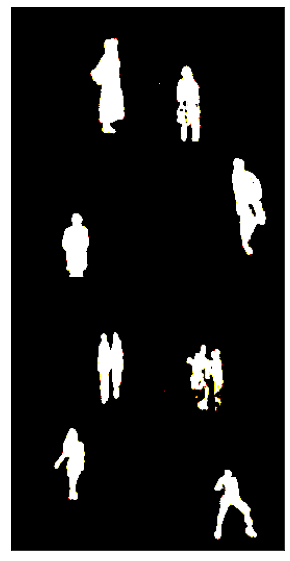

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6180, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0401, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [10000/40000 (50%)]	 Loss: 1.276126
Batch ID: 2500


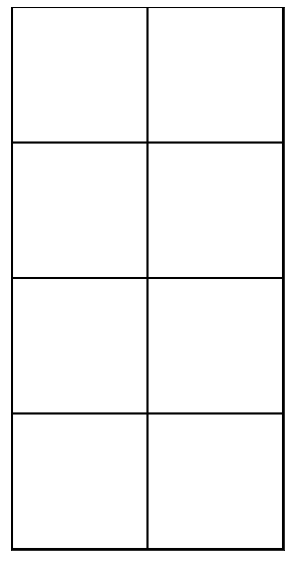

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


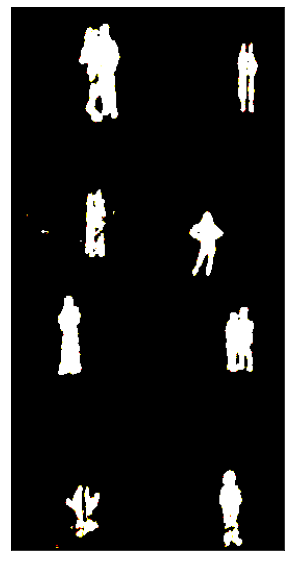

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6186, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0363, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [12000/40000 (60%)]	 Loss: 1.273530
Batch ID: 3000


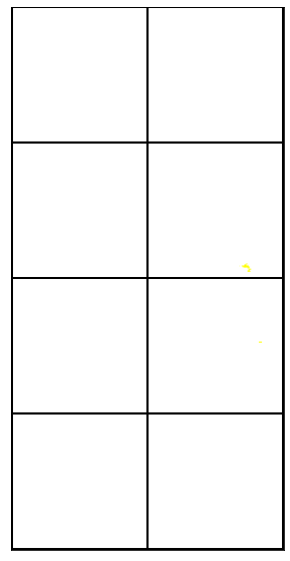

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


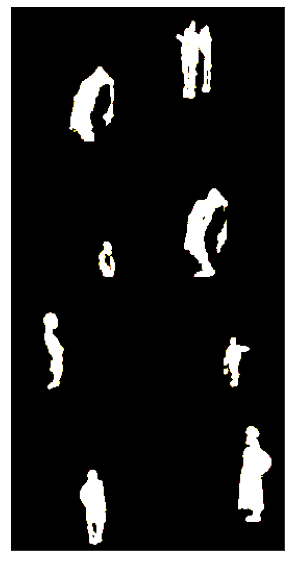

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6393, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0284, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [14000/40000 (70%)]	 Loss: 1.306999
Batch ID: 3500


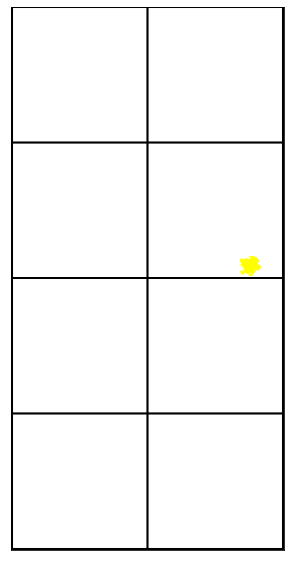

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


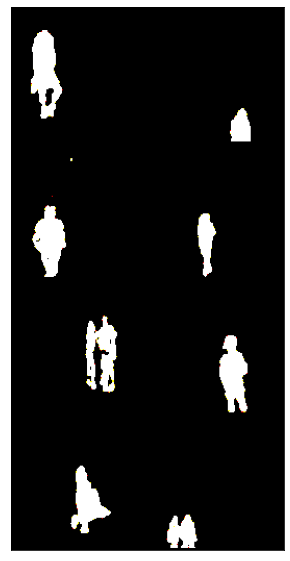

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6330, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0380, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [16000/40000 (80%)]	 Loss: 1.304126
Batch ID: 4000


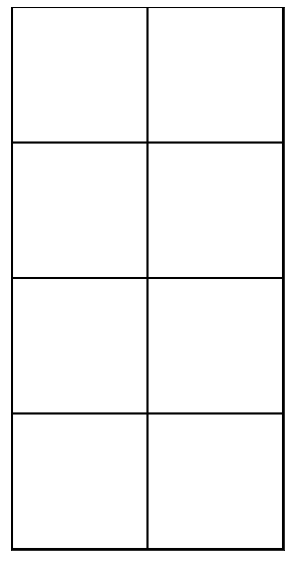

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


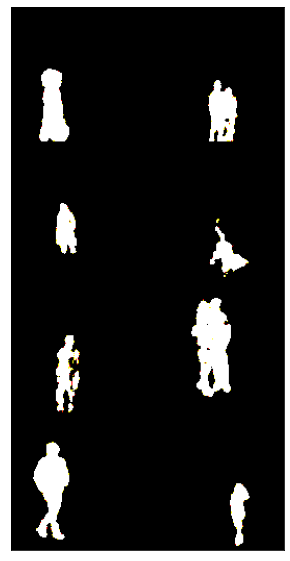

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6383, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 4 [18000/40000 (90%)]	 Loss: 1.308233
Batch ID: 4500


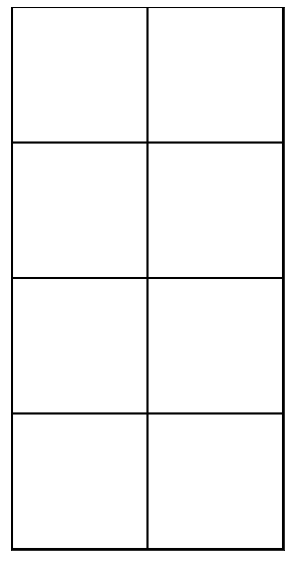

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


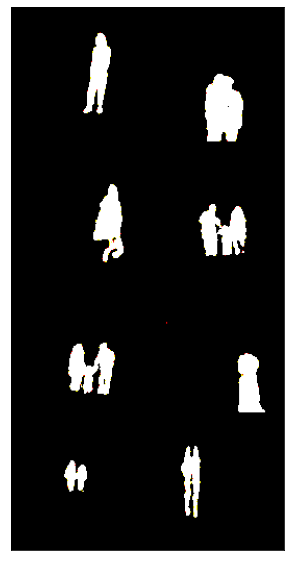

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6322, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0401, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [0/40000 (0%)]	 Loss: 1.304444
Batch ID: 0


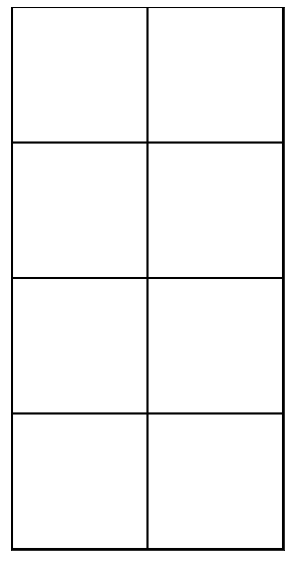

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


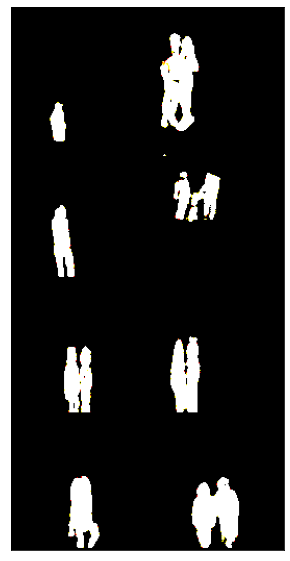

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6425, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0284, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [2000/40000 (10%)]	 Loss: 1.313304
Batch ID: 500


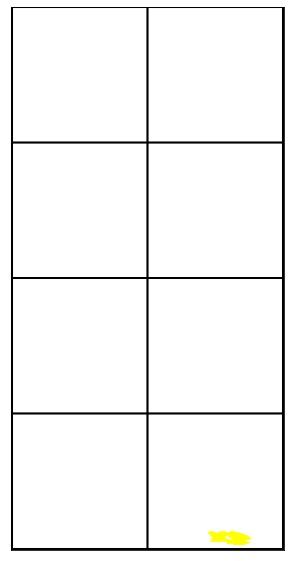

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


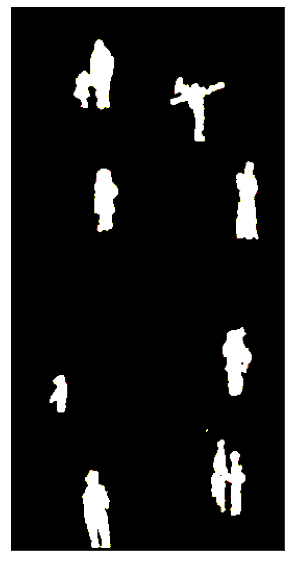

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6432, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [4000/40000 (20%)]	 Loss: 1.311210
Batch ID: 1000


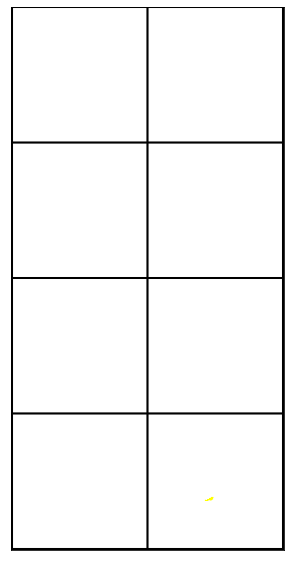

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


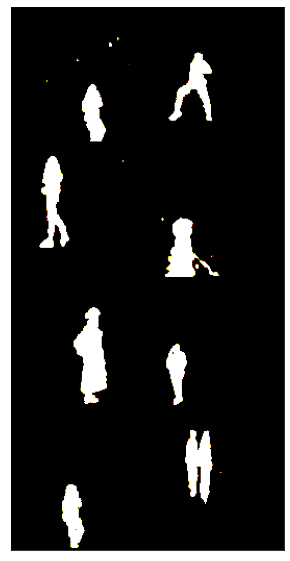

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6248, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0357, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [6000/40000 (30%)]	 Loss: 1.285284
Batch ID: 1500


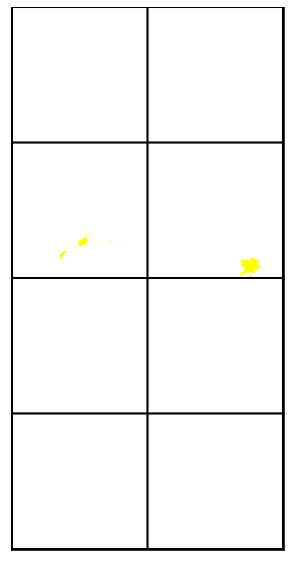

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


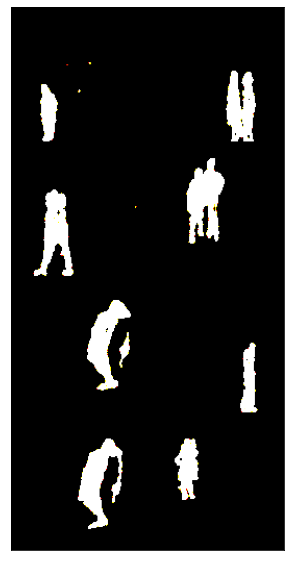

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6462, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0420, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [8000/40000 (40%)]	 Loss: 1.334327
Batch ID: 2000


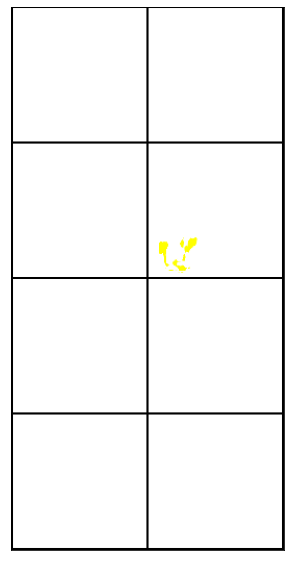

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


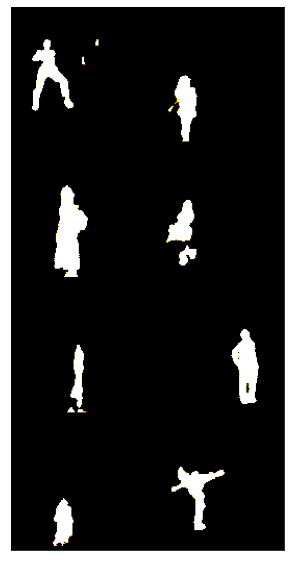

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.5991, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0438, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [10000/40000 (50%)]	 Loss: 1.242087
Batch ID: 2500


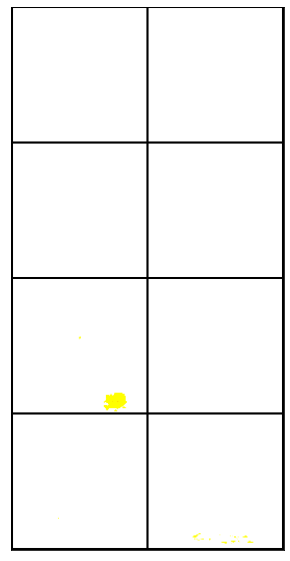

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


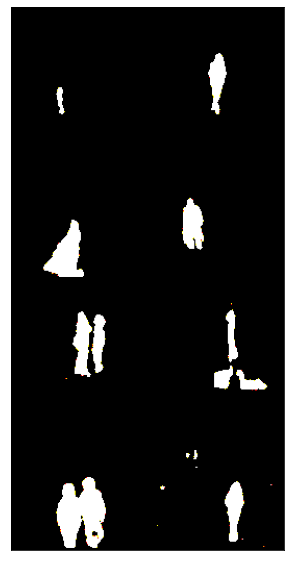

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6253, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0417, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [12000/40000 (60%)]	 Loss: 1.292224
Batch ID: 3000


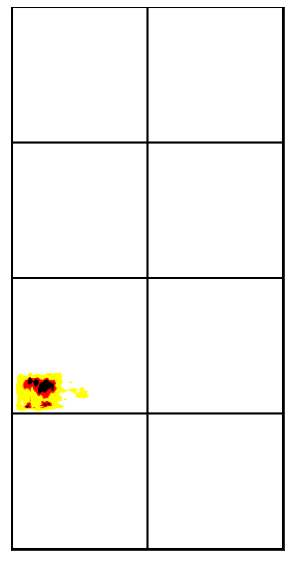

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


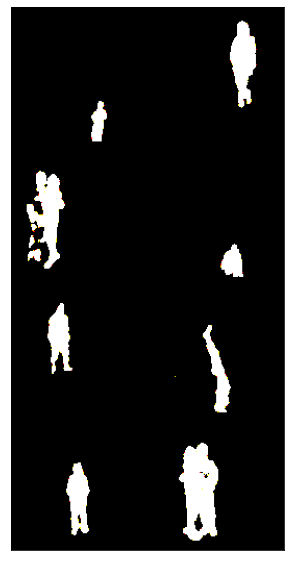

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6080, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [14000/40000 (70%)]	 Loss: 1.242151
Batch ID: 3500


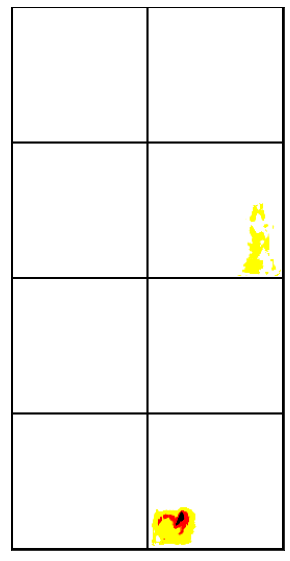

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


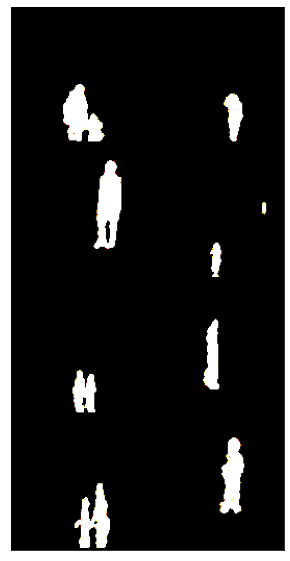

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6171, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0408, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [16000/40000 (80%)]	 Loss: 1.274913
Batch ID: 4000


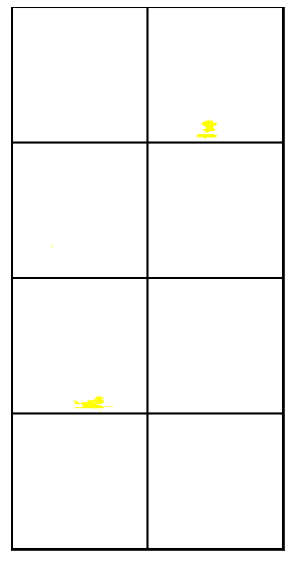

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


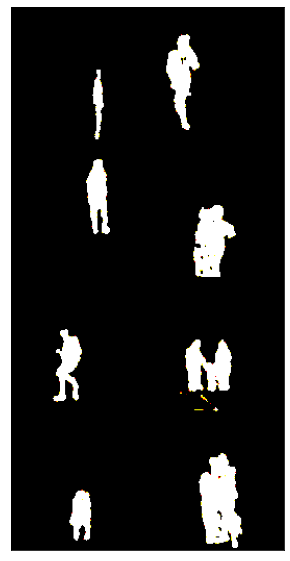

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6369, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 5 [18000/40000 (90%)]	 Loss: 1.300873
Batch ID: 4500


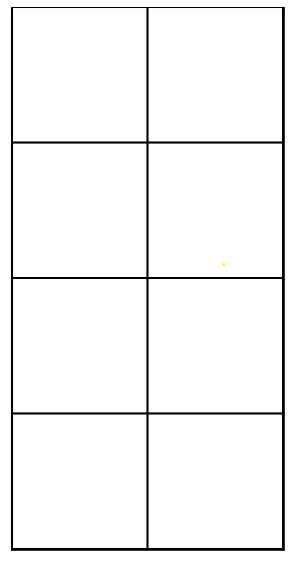

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


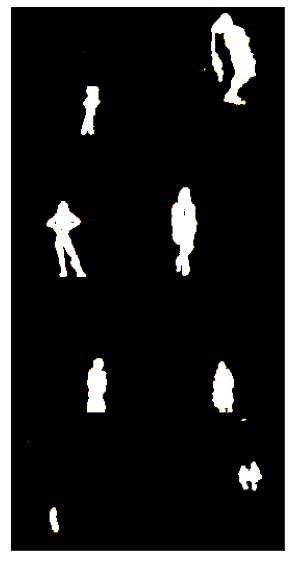

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6093, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0359, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [0/40000 (0%)]	 Loss: 1.254588
Batch ID: 0


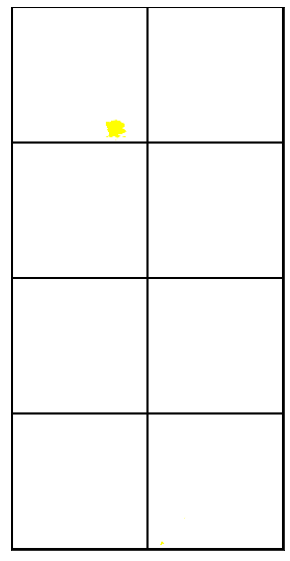

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


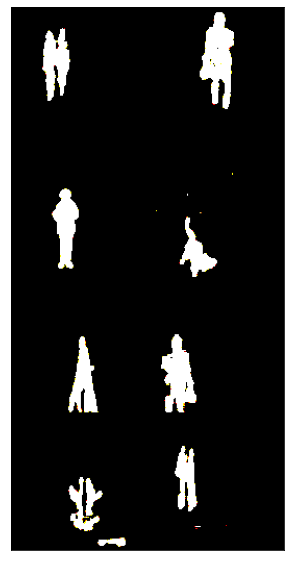

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6372, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [2000/40000 (10%)]	 Loss: 1.303725
Batch ID: 500


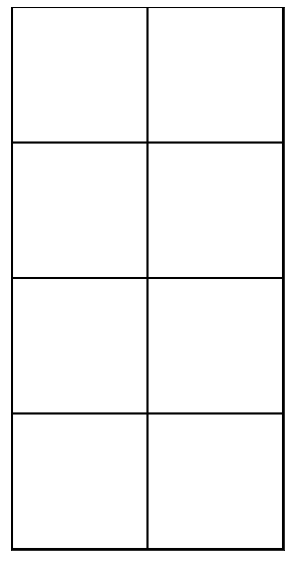

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


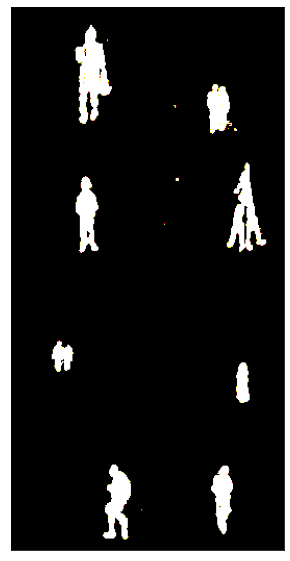

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6285, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0366, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [4000/40000 (20%)]	 Loss: 1.293566
Batch ID: 1000


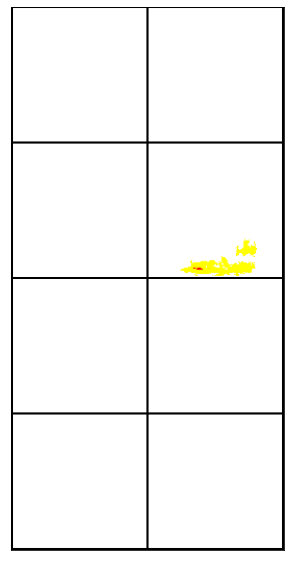

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


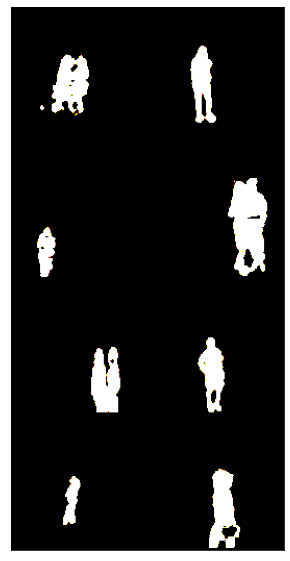

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6440, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [6000/40000 (30%)]	 Loss: 1.315577
Batch ID: 1500


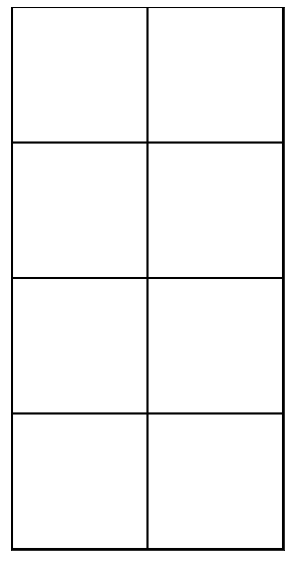

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


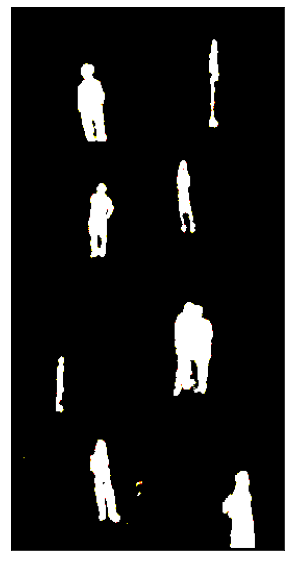

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6403, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [8000/40000 (40%)]	 Loss: 1.305104
Batch ID: 2000


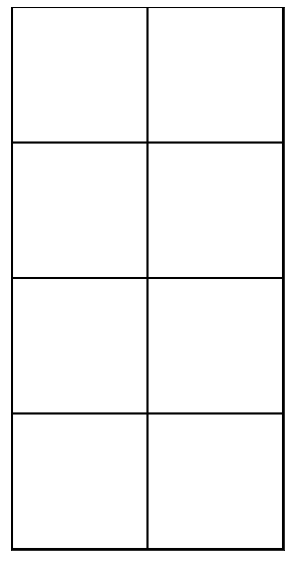

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


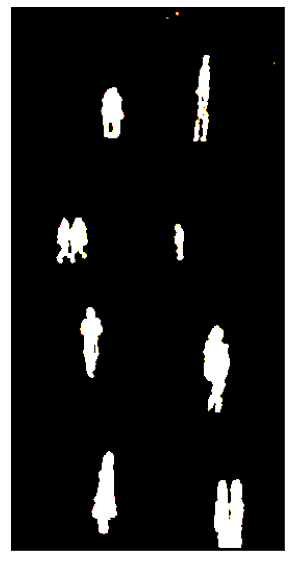

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6085, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0311, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [10000/40000 (50%)]	 Loss: 1.248212
Batch ID: 2500


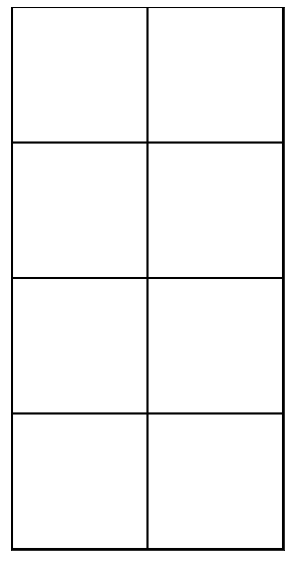

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


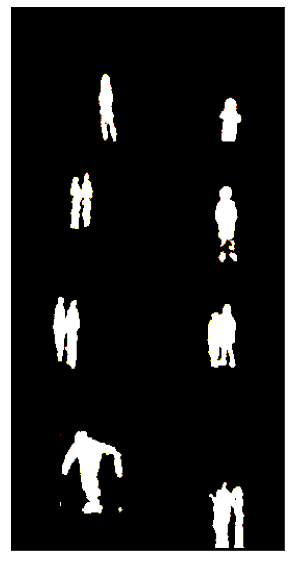

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6361, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0365, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [12000/40000 (60%)]	 Loss: 1.308616
Batch ID: 3000


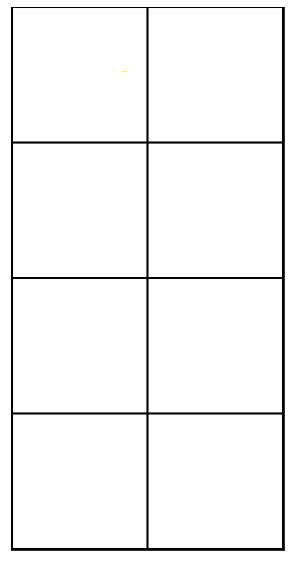

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


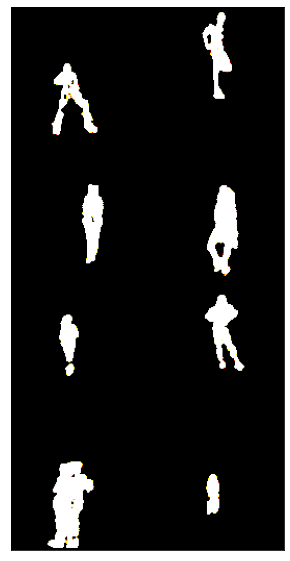

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6390, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0324, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [14000/40000 (70%)]	 Loss: 1.310477
Batch ID: 3500


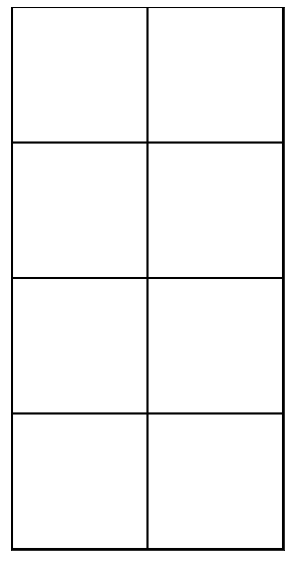

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


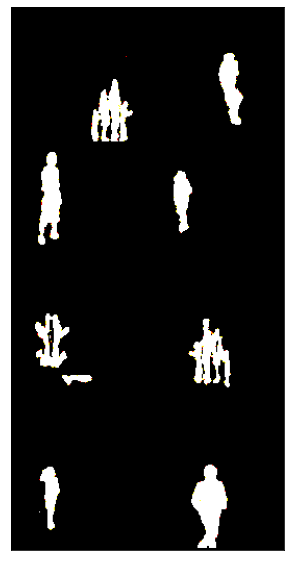

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6414, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0323, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [16000/40000 (80%)]	 Loss: 1.315130
Batch ID: 4000


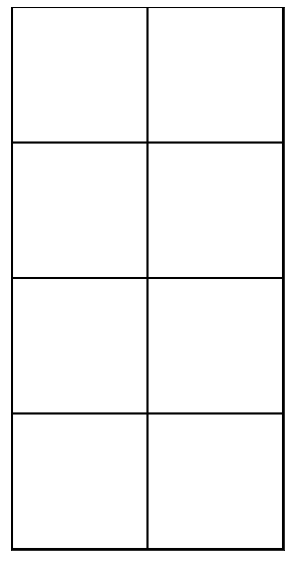

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


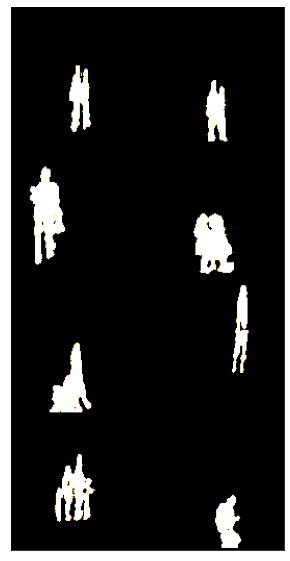

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6321, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 6 [18000/40000 (90%)]	 Loss: 1.291888
Batch ID: 4500


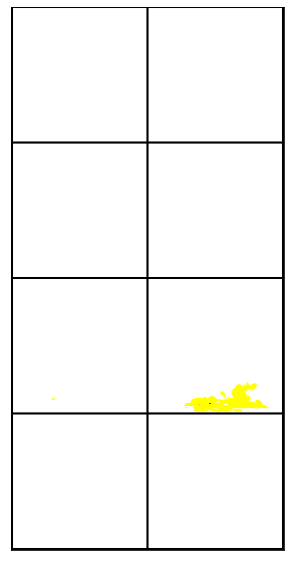

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


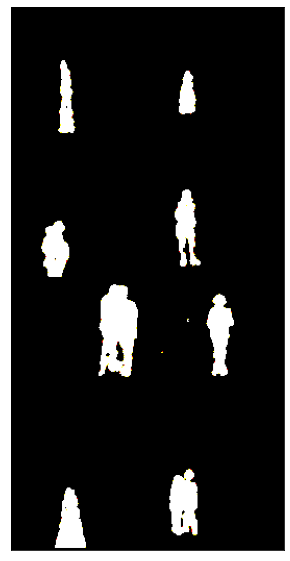

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6425, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0258, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [0/40000 (0%)]	 Loss: 1.310767
Batch ID: 0


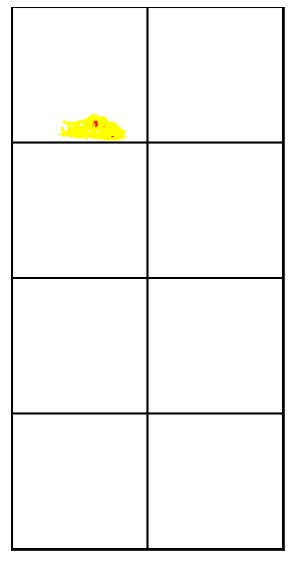

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


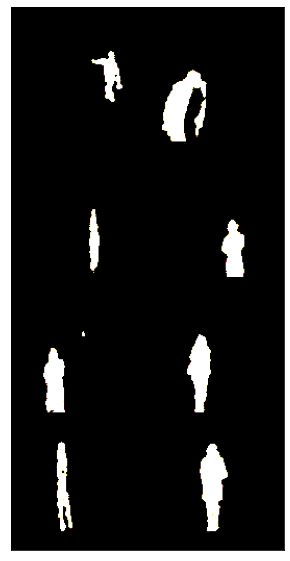

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6488, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0357, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [2000/40000 (10%)]	 Loss: 1.333391
Batch ID: 500


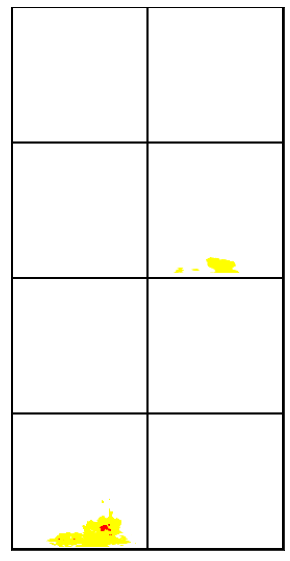

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


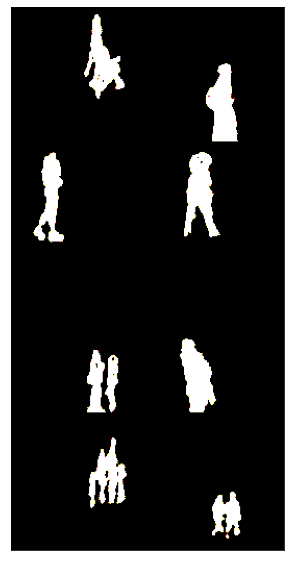

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6203, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0361, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [4000/40000 (20%)]	 Loss: 1.276628
Batch ID: 1000


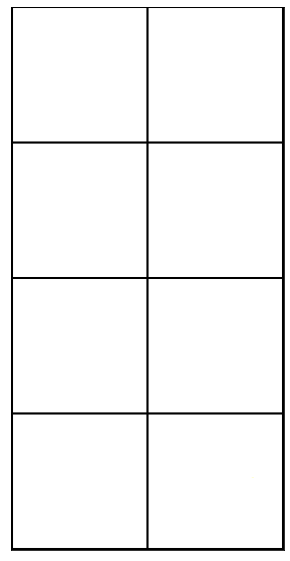

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


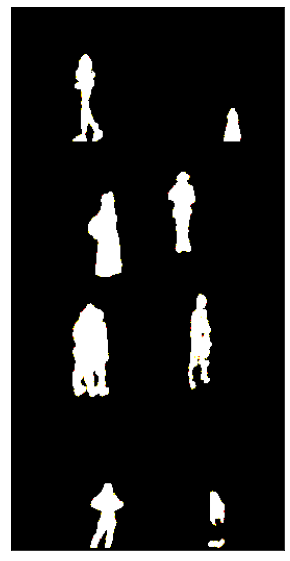

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6568, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0321, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [6000/40000 (30%)]	 Loss: 1.345776
Batch ID: 1500


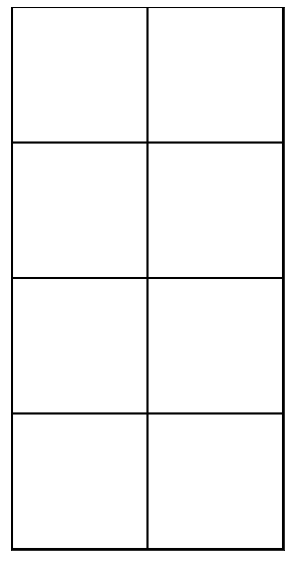

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


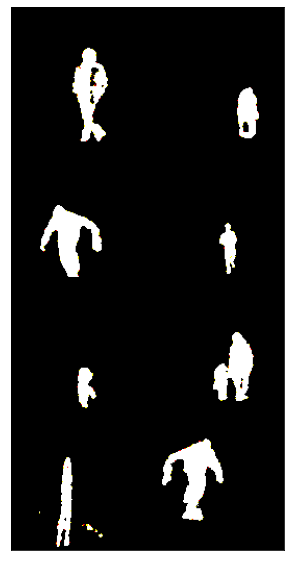

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6595, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [8000/40000 (40%)]	 Loss: 1.349390
Batch ID: 2000


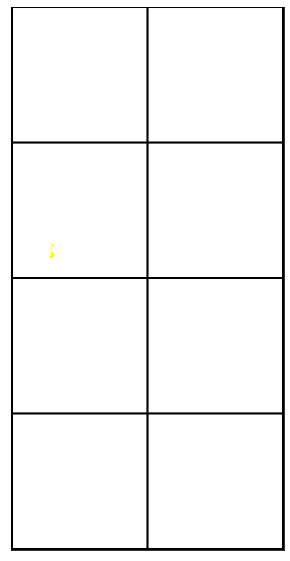

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


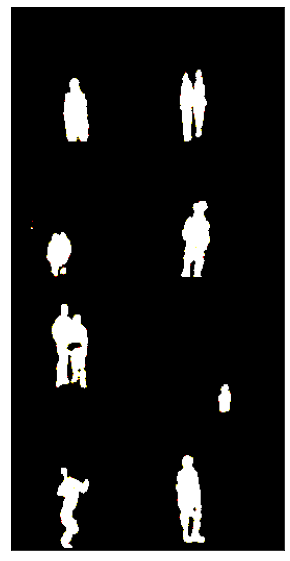

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6312, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0365, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [10000/40000 (50%)]	 Loss: 1.298938
Batch ID: 2500


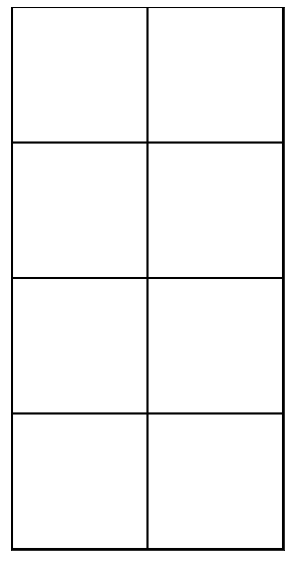

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


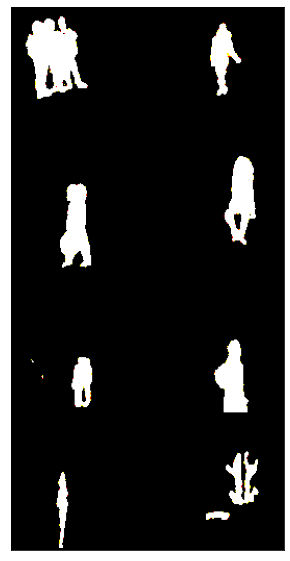

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6094, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0309, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [12000/40000 (60%)]	 Loss: 1.249625
Batch ID: 3000


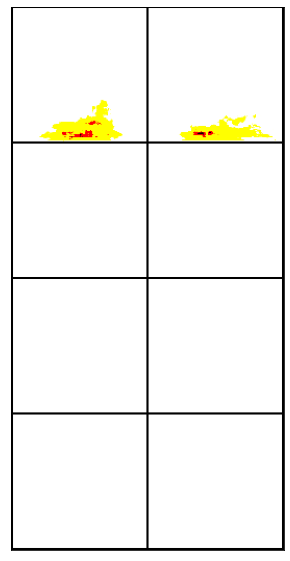

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


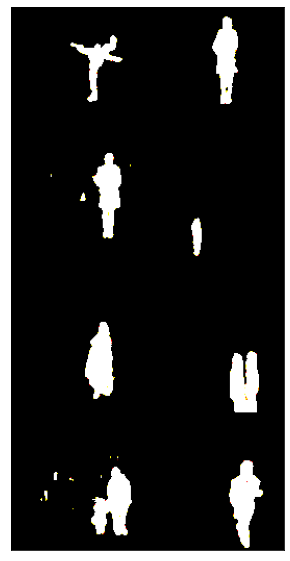

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6305, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0285, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [14000/40000 (70%)]	 Loss: 1.289414
Batch ID: 3500


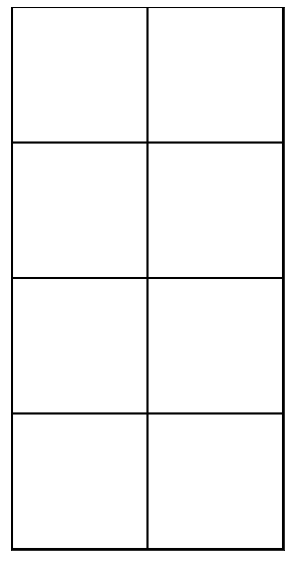

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


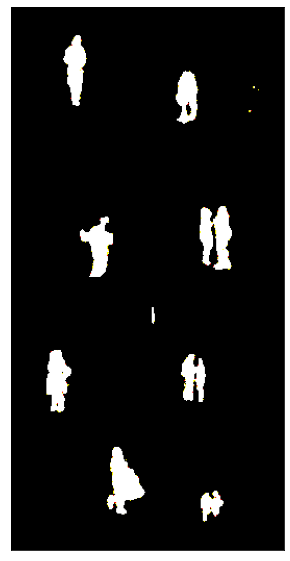

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6117, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [16000/40000 (80%)]	 Loss: 1.250391
Batch ID: 4000


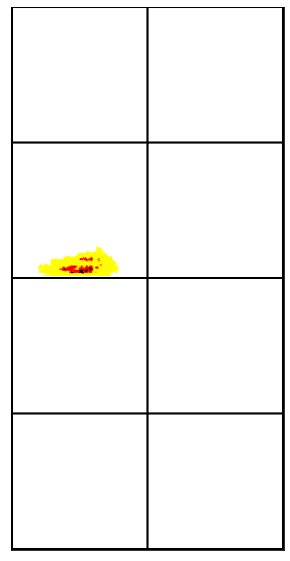

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


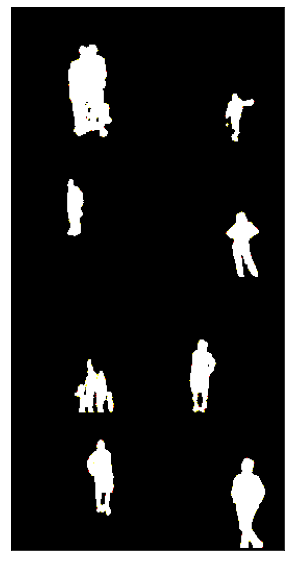

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6223, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 7 [18000/40000 (90%)]	 Loss: 1.273950
Batch ID: 4500


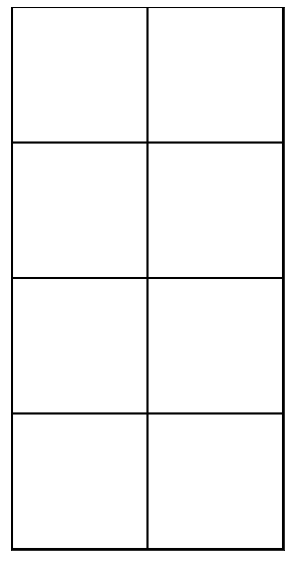

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


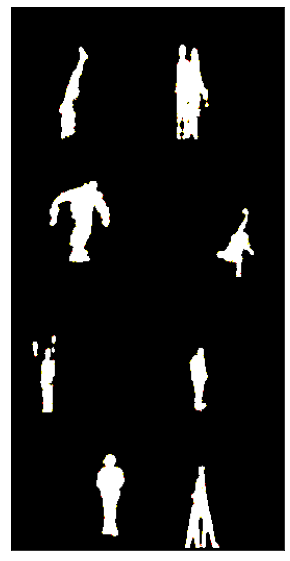

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6224, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0488, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [0/40000 (0%)]	 Loss: 1.293673
Batch ID: 0


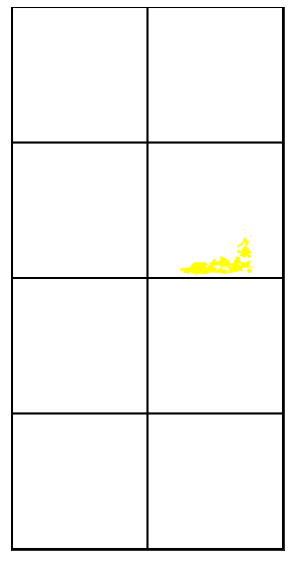

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


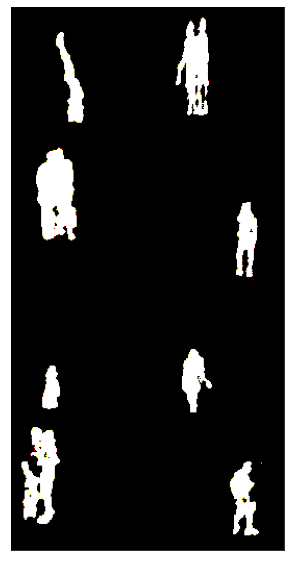

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6328, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0371, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [2000/40000 (10%)]	 Loss: 1.302766
Batch ID: 500


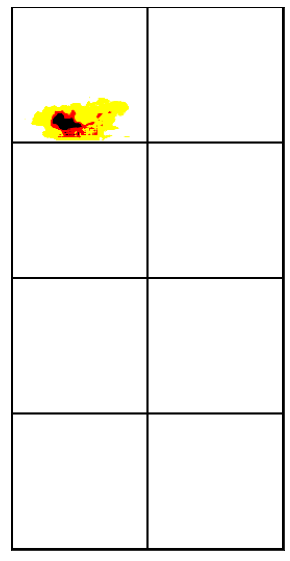

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


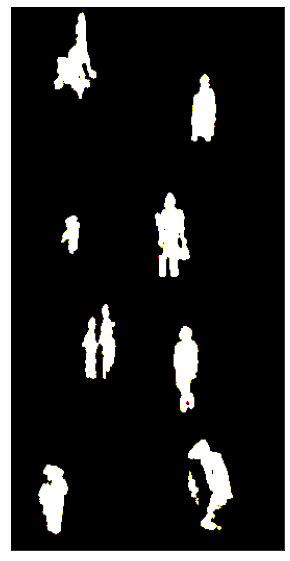

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6559, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0248, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [4000/40000 (20%)]	 Loss: 1.336574
Batch ID: 1000


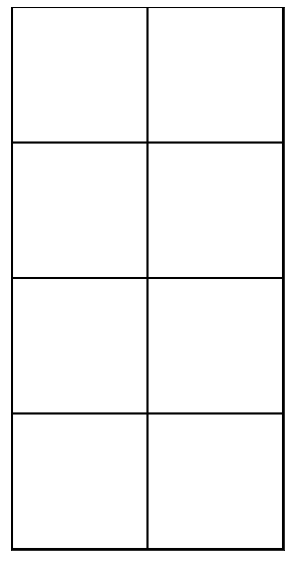

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


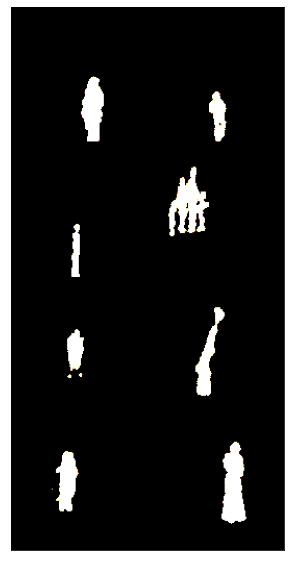

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6115, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0437, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [6000/40000 (30%)]	 Loss: 1.266771
Batch ID: 1500


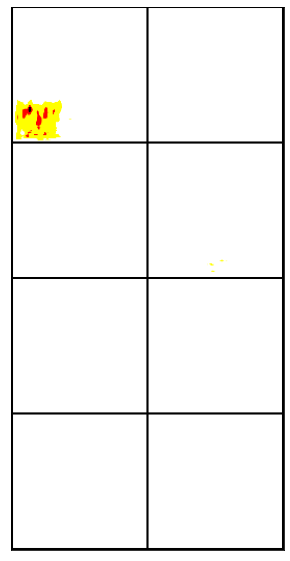

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


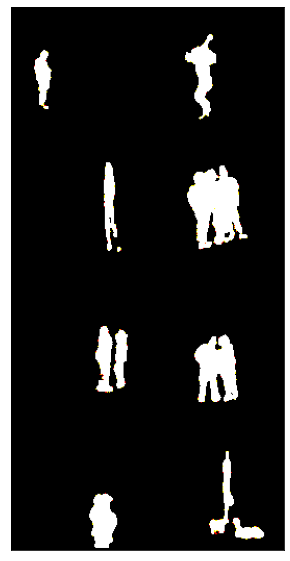

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6257, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0338, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [8000/40000 (40%)]	 Loss: 1.285215
Batch ID: 2000


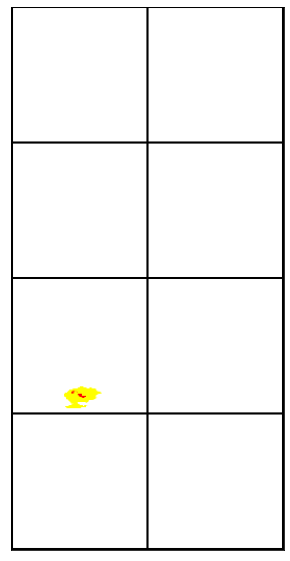

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


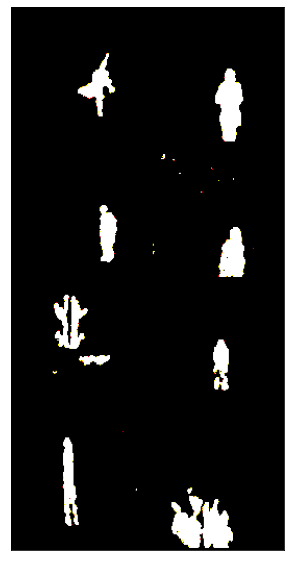

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6398, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0404, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [10000/40000 (50%)]	 Loss: 1.319890
Batch ID: 2500


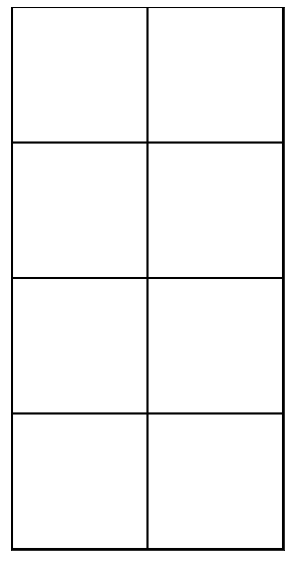

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


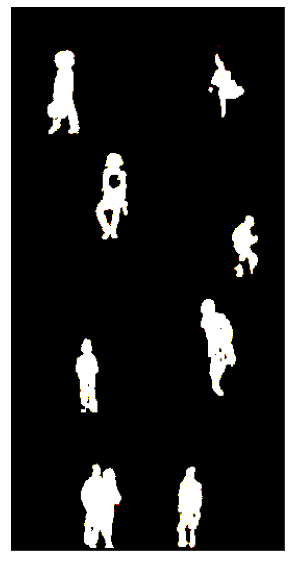

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6164, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0302, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [12000/40000 (60%)]	 Loss: 1.262944
Batch ID: 3000


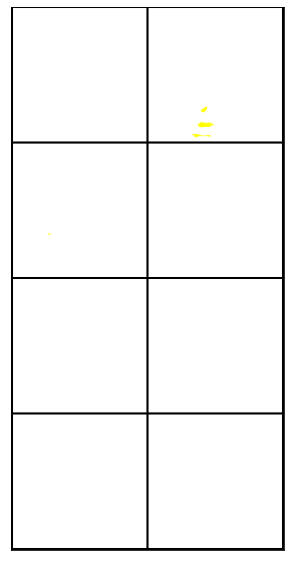

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


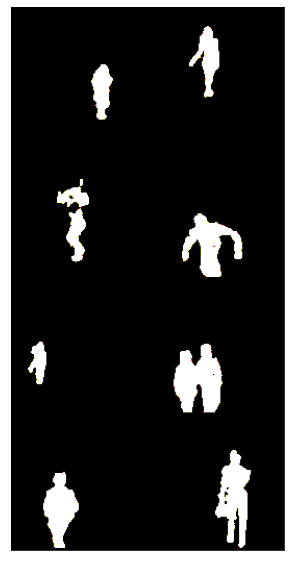

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6399, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0521, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [14000/40000 (70%)]	 Loss: 1.332002
Batch ID: 3500


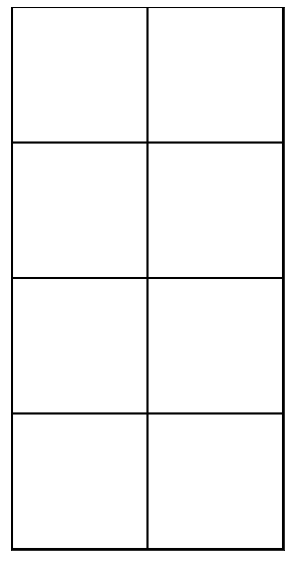

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


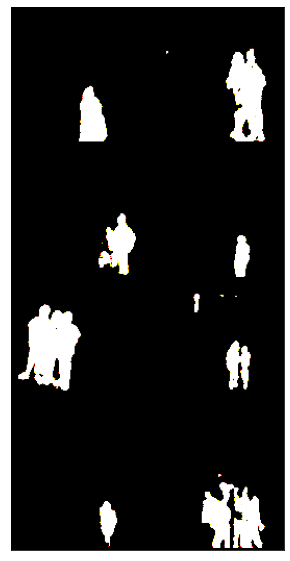

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6223, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0363, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [16000/40000 (80%)]	 Loss: 1.280897
Batch ID: 4000


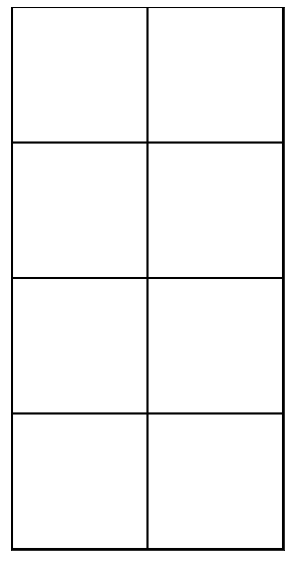

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


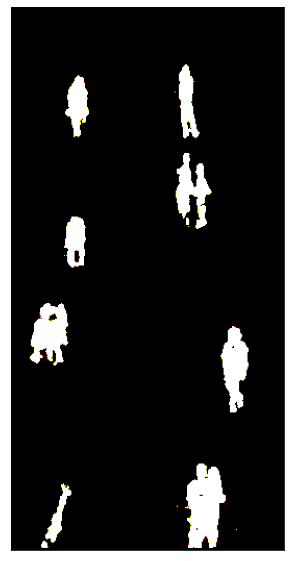

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6356, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0308, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 8 [18000/40000 (90%)]	 Loss: 1.301871
Batch ID: 4500


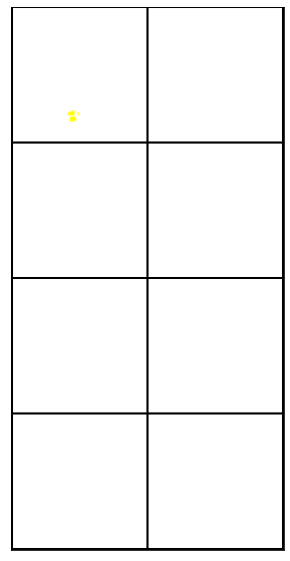

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


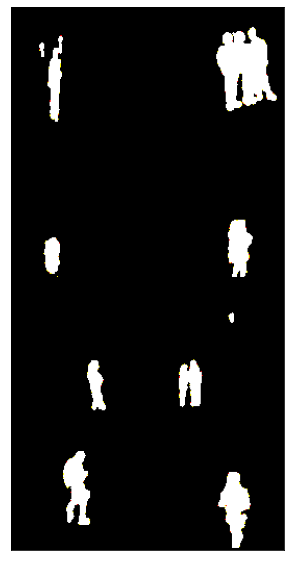

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6553, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0283, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [0/40000 (0%)]	 Loss: 1.338976
Batch ID: 0


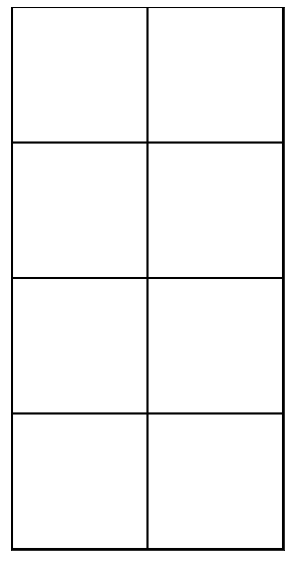

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


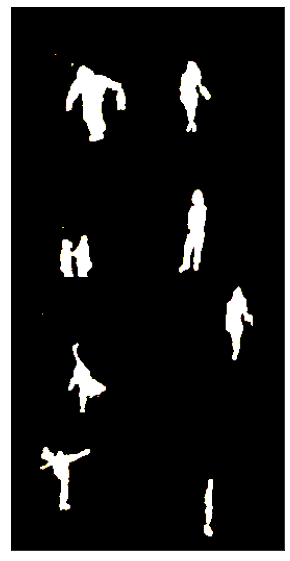

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6288, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [2000/40000 (10%)]	 Loss: 1.287285
Batch ID: 500


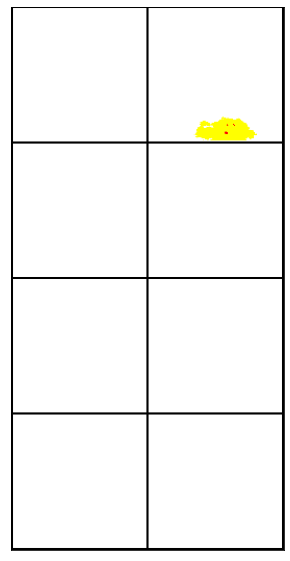

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


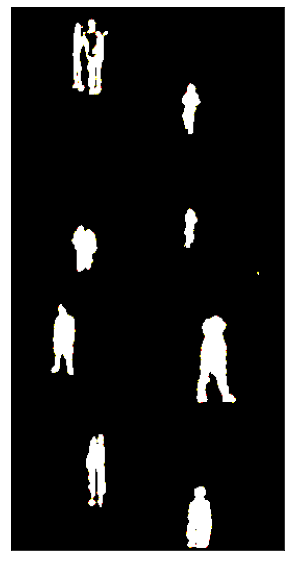

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6119, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0352, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [4000/40000 (20%)]	 Loss: 1.259103
Batch ID: 1000


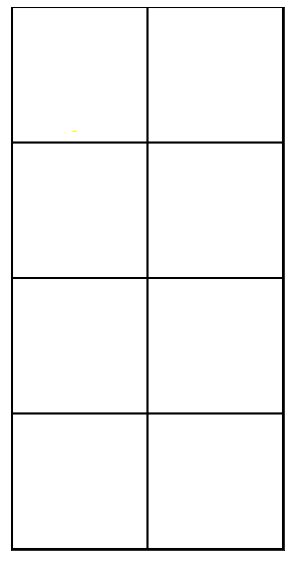

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


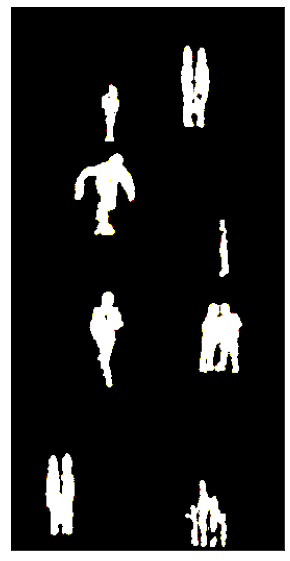

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6352, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [6000/40000 (30%)]	 Loss: 1.295739
Batch ID: 1500


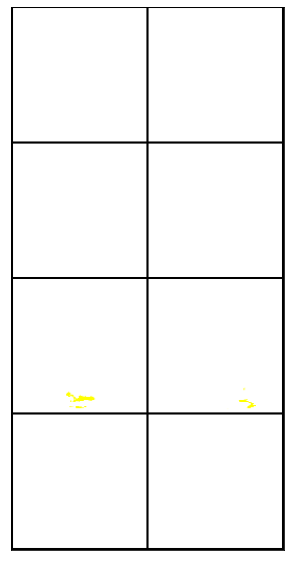

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


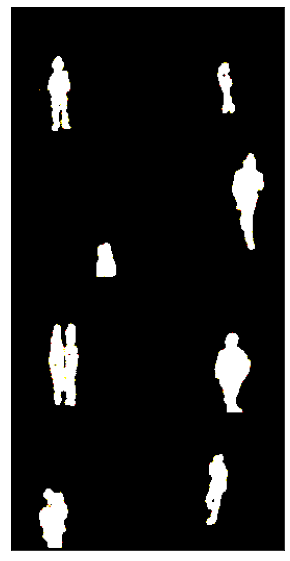

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6173, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [8000/40000 (40%)]	 Loss: 1.260824
Batch ID: 2000


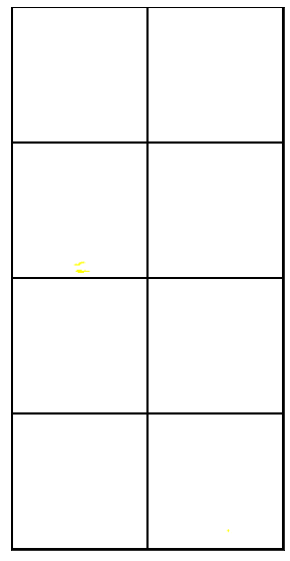

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


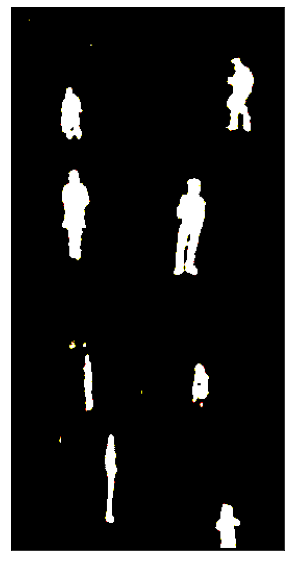

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6132, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0336, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [10000/40000 (50%)]	 Loss: 1.259875
Batch ID: 2500


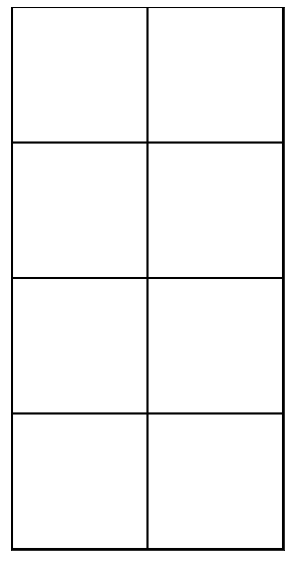

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


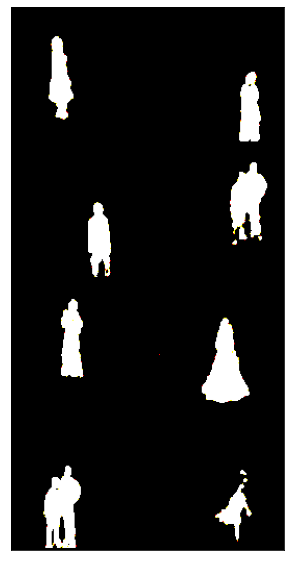

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6155, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0420, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [12000/40000 (60%)]	 Loss: 1.272940
Batch ID: 3000


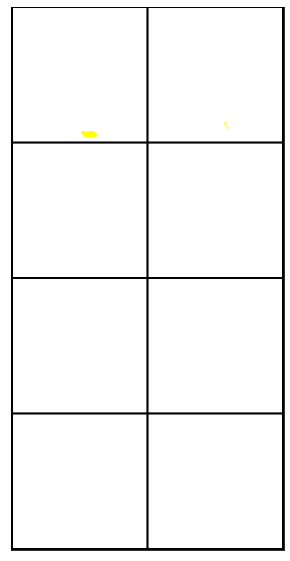

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


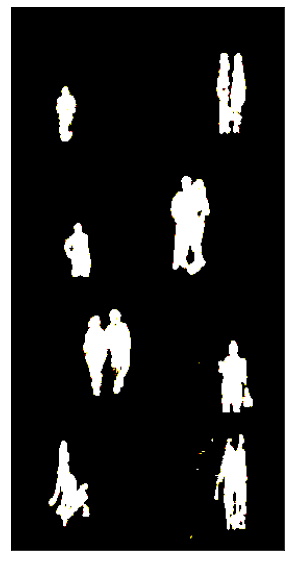

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6185, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [14000/40000 (70%)]	 Loss: 1.262123
Batch ID: 3500


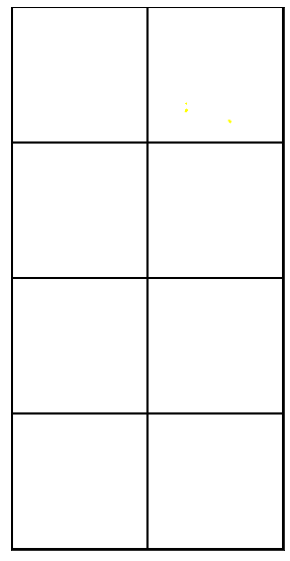

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


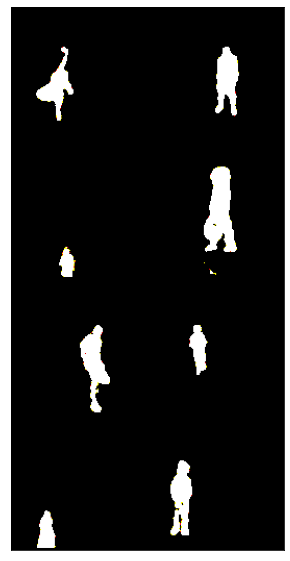

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6293, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0323, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [16000/40000 (80%)]	 Loss: 1.290928
Batch ID: 4000


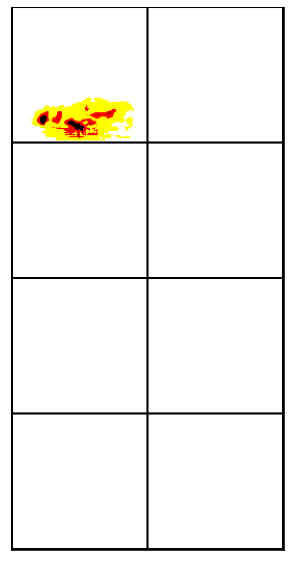

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


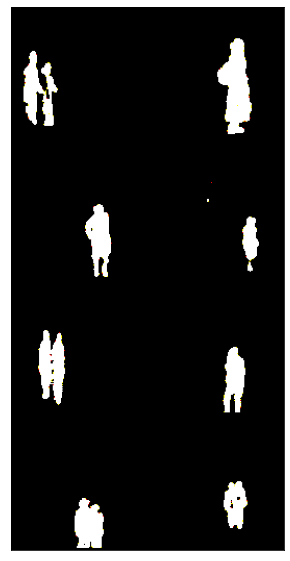

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6191, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
tensor(0.0357, device='cuda:0', grad_fn=<BinaryCrossEntropyWithLogitsBackward>)
Train Epoch: 9 [18000/40000 (90%)]	 Loss: 1.273882
Batch ID: 4500


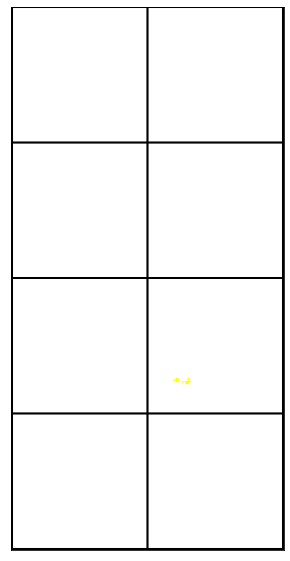

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


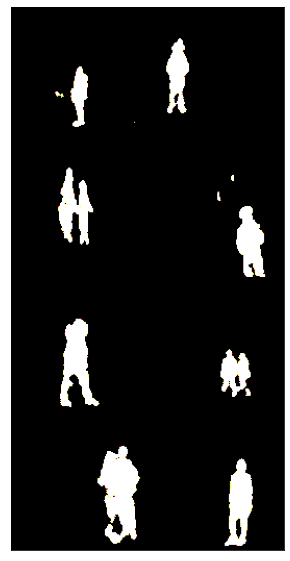

In [29]:
optim = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=1e-5)
criterion = nn.BCEWithLogitsLoss()

scheduler = StepLR(optim, step_size=2, gamma=0.01)
for epoch in range(1, 10):
    train(model, criterion, device, train_loader, optim, epoch)
    scheduler.step()

In [0]:
!pip install torchsummary
from torchsummary import summary


In [0]:
!pip install kornia
from kornia.losses import SSIM

     |████████████████████████████████| 163kB 2.7MB/s 


In [0]:
!pip install tensorboardX

     |████████████████████████████████| 204kB 2.7MB/s 


In [0]:
torch.cuda.empty_cache()

In [0]:
from tensorboardX import SummaryWriter 

In [0]:
writer = SummaryWriter() # Saves the summaries to default directory names 'runs' in the current parent directory 


In [0]:
def tensorboardImage(tensors, *args, **kwargs):
    mean, std = torch.tensor([0.485, 0.456, 0.406])*255, torch.tensor([0.229, 0.224, 0.225])*255
    tensors = (tensors * std[None, :, None, None]) + mean[None, :, None, None]
    try:
        tensors = tensors.detach().cpu()
    except:
        pass
    grid_tensor = torchvision.utils.make_grid(tensors, *args, **kwargs)
    return grid_tensor

In [0]:
%load_ext tensorboard


In [0]:
# %reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [0]:
kernel_size=3
criterion = SSIM(kernel_size, reduction="mean")
